In [2]:
import nltk
from urllib.request import urlopen
from bs4 import BeautifulSoup
import requests
import urllib
from nltk.corpus import PlaintextCorpusReader
import pandas as pd
import urllib.request
import string
import re
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from kneed import KneeLocator
from sklearn.metrics import silhouette_samples,silhouette_score
from array import *
from nltk.probability import FreqDist
import squarify
from itertools import chain
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import random
import pickle
from yellowbrick.cluster import KElbowVisualizer
import pysentiment2 as ps
from nrclex import NRCLex
from nltk.corpus import sentiwordnet as swn
from nltk import pos_tag
from nltk import map_tag
import ssl
from nltk.corpus import wordnet as wn
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

In [4]:
bsensedata = pd.read_csv('bsensedata.csv')
score_speeches_merge_date = pd.read_csv('score_speeches_merge_date.csv')
score_mpc_merge_date = pd.read_csv('score_mpc_merge_date.csv')

In [5]:
for i in range(0,len(bsensedata),1):
    bsensedata.loc[i,"BSE_V1"] = (bsensedata['Close_BSE'][i]-bsensedata['Open_BSE'][i])/bsensedata['Open_BSE'][i]
    bsensedata.loc[i,"NSE_V1"] = (bsensedata['Close_NSE'][i]-bsensedata['Open_NSE'][i])/bsensedata['Open_NSE'][i]

In [6]:
for i in range(1,len(bsensedata),1):
    bsensedata.loc[i,"BSE_V2"] = (bsensedata['Open_BSE'][i]-bsensedata['Close_BSE'][i-1])/bsensedata['Close_BSE'][i-1]
    bsensedata.loc[i,"NSE_V2"] = (bsensedata['Open_NSE'][i]-bsensedata['Close_NSE'][i-1])/bsensedata['Close_NSE'][i-1]

In [7]:
bsensedata.index = pd.to_datetime(bsensedata['Date'])
score_speeches_merge_date.index = pd.to_datetime(score_speeches_merge_date['date'])
score_mpc_merge_date.index = pd.to_datetime(score_mpc_merge_date['date'])

In [8]:
speeches_date = pd.to_datetime(score_speeches_merge_date['date'])
mpc_date = pd.to_datetime(score_mpc_merge_date['date'])

In [9]:
for i in range (0,len(bsensedata.index),1):
    x = bsensedata.index[i]
    x = x.strftime("%Y-%m-%d")
    
    for j in range (0,len(score_speeches_merge_date.index),1):
        a = score_speeches_merge_date.index[j]
        a = a.strftime("%Y-%m-%d")
        
        if (x==a):
            t_p = bsensedata.index[i-1]
            t_p = t_p.strftime("%Y-%m-%d")
            t_n = bsensedata.index[i+1]
            t_n = t_n.strftime("%Y-%m-%d")
            bsensedata.loc[x,"BSE_V1_speeches_avg"] = (bsensedata.loc[t_p,"BSE_V1"]+bsensedata.loc[x,"BSE_V1"]+bsensedata.loc[t_n,"BSE_V1"])/3
            bsensedata.loc[x,"BSE_V1_speeches_avg_abs"] = (abs(bsensedata.loc[t_p,"BSE_V1"])+abs(bsensedata.loc[x,"BSE_V1"])+abs(bsensedata.loc[t_n,"BSE_V1"]))/3
            bsensedata.loc[x,"BSE_V2_speeches_avg"] = (bsensedata.loc[t_p,"BSE_V2"]+bsensedata.loc[x,"BSE_V2"]+bsensedata.loc[t_n,"BSE_V2"])/3
            bsensedata.loc[x,"BSE_V2_speeches_avg_abs"] = (abs(bsensedata.loc[t_p,"BSE_V2"])+abs(bsensedata.loc[x,"BSE_V2"])+abs(bsensedata.loc[t_n,"BSE_V2"]))/3
            bsensedata.loc[x,"NSE_V1_speeches_avg"] = (bsensedata.loc[t_p,"NSE_V1"]+bsensedata.loc[x,"NSE_V1"]+bsensedata.loc[t_n,"NSE_V1"])/3
            bsensedata.loc[x,"NSE_V1_speeches_avg_abs"] = (abs(bsensedata.loc[t_p,"NSE_V1"])+abs(bsensedata.loc[x,"NSE_V1"])+abs(bsensedata.loc[t_n,"NSE_V1"]))/3
            bsensedata.loc[x,"NSE_V2_speeches_avg"] = (bsensedata.loc[t_p,"NSE_V2"]+bsensedata.loc[x,"NSE_V2"]+bsensedata.loc[t_n,"NSE_V2"])/3
            bsensedata.loc[x,"NSE_V2_speeches_avg_abs"] = (abs(bsensedata.loc[t_p,"NSE_V2"])+abs(bsensedata.loc[x,"NSE_V2"])+abs(bsensedata.loc[t_n,"NSE_V2"]))/3

In [10]:
for i in range (0,len(bsensedata.index),1):
    x = bsensedata.index[i]
    x = x.strftime("%Y-%m-%d")
    
    for j in range (0,len(score_mpc_merge_date.index),1):
        a = score_mpc_merge_date.index[j]
        a = a.strftime("%Y-%m-%d")
        
        if (x==a):
            t_p = bsensedata.index[i-1]
            t_p = t_p.strftime("%Y-%m-%d")
            t_n = bsensedata.index[i+1]
            t_n = t_n.strftime("%Y-%m-%d")
            bsensedata.loc[x,"BSE_V1_mpc_avg"] = (bsensedata.loc[t_p,"BSE_V1"]+bsensedata.loc[x,"BSE_V1"]+bsensedata.loc[t_n,"BSE_V1"])/3
            bsensedata.loc[x,"BSE_V1_mpc_avg_abs"] = (abs(bsensedata.loc[t_p,"BSE_V1"])+abs(bsensedata.loc[x,"BSE_V1"])+abs(bsensedata.loc[t_n,"BSE_V1"]))/3
            bsensedata.loc[x,"BSE_V2_mpc_avg"] = (bsensedata.loc[t_p,"BSE_V2"]+bsensedata.loc[x,"BSE_V2"]+bsensedata.loc[t_n,"BSE_V2"])/3
            bsensedata.loc[x,"BSE_V2_mpc_avg_abs"] = (abs(bsensedata.loc[t_p,"BSE_V2"])+abs(bsensedata.loc[x,"BSE_V2"])+abs(bsensedata.loc[t_n,"BSE_V2"]))/3
            bsensedata.loc[x,"NSE_V1_mpc_avg"] = (bsensedata.loc[t_p,"NSE_V1"]+bsensedata.loc[x,"NSE_V1"]+bsensedata.loc[t_n,"NSE_V1"])/3
            bsensedata.loc[x,"NSE_V1_mpc_avg_abs"] = (abs(bsensedata.loc[t_p,"NSE_V1"])+abs(bsensedata.loc[x,"NSE_V1"])+abs(bsensedata.loc[t_n,"NSE_V1"]))/3
            bsensedata.loc[x,"NSE_V2_mpc_avg"] = (bsensedata.loc[t_p,"NSE_V2"]+bsensedata.loc[x,"NSE_V2"]+bsensedata.loc[t_n,"NSE_V2"])/3
            bsensedata.loc[x,"NSE_V2_mpc_avg_abs"] = (abs(bsensedata.loc[t_p,"NSE_V2"])+abs(bsensedata.loc[x,"NSE_V2"])+abs(bsensedata.loc[t_n,"NSE_V2"]))/3

In [11]:
for i in range (0,len(bsensedata.index),1):
    x = bsensedata.index[i]
    x = x.strftime("%Y-%m-%d")
    
    for j in range (0,len(score_mpc_merge_date.index),1):
        a = score_mpc_merge_date.index[j]
        a = a.strftime("%Y-%m-%d")
        
        if (x==a):
            t_p = bsensedata.index[i-1]
            t_p = t_p.strftime("%Y-%m-%d")
            t_n = bsensedata.index[i+1]
            t_n = t_n.strftime("%Y-%m-%d")
            bsensedata.loc[x,"current_dummy_mpc"] = 1
            bsensedata.loc[t_p,"prior_dummy_mpc"] = 1
            bsensedata.loc[t_n,"post_dummy_mpc"] = 1

In [12]:
for i in range (0,len(bsensedata.index),1):
    x = bsensedata.index[i]
    x = x.strftime("%Y-%m-%d")
    
    for j in range (0,len(score_speeches_merge_date.index),1):
        a = score_speeches_merge_date.index[j]
        a = a.strftime("%Y-%m-%d")
        
        if (x==a):
            t_p = bsensedata.index[i-1]
            t_p = t_p.strftime("%Y-%m-%d")
            t_n = bsensedata.index[i+1]
            t_n = t_n.strftime("%Y-%m-%d")
            bsensedata.loc[x,"current_dummy_speeches"] = 1
            bsensedata.loc[t_p,"prior_dummy_speeches"] = 1
            bsensedata.loc[t_n,"post_dummy_speeches"] = 1

In [13]:
bsensedata['current_dummy_mpc'] = bsensedata['current_dummy_mpc'].fillna(0)
bsensedata['prior_dummy_mpc'] = bsensedata['prior_dummy_mpc'].fillna(0)
bsensedata['post_dummy_mpc'] = bsensedata['post_dummy_mpc'].fillna(0)
bsensedata['current_dummy_speeches'] = bsensedata['current_dummy_speeches'].fillna(0)
bsensedata['prior_dummy_speeches'] = bsensedata['prior_dummy_speeches'].fillna(0)
bsensedata['post_dummy_speeches'] = bsensedata['post_dummy_speeches'].fillna(0)

In [14]:
for i in range (0,len(bsensedata.index),1):
    x = bsensedata.index[i]
    x = x.strftime("%Y-%m-%d")
    
    for j in range (0,len(score_speeches_merge_date.index),1):
        a = score_speeches_merge_date.index[j]
        a = a.strftime("%Y-%m-%d")
        
        if (x==a):
            bsensedata.loc[x,"speeches_Loughran_Polarity"] = score_speeches_merge_date.loc[x,'Loughran_Polarity']
            bsensedata.loc[x,"speeches_Loughran_Subjectivity"] = score_speeches_merge_date.loc[x,'Loughran_Subjectivity']
            bsensedata.loc[x,"speeches_NRC_Polarity"] = score_speeches_merge_date.loc[x,'NRC_Polarity']
            bsensedata.loc[x,"speeches_Financial_Stab_Score"] = score_speeches_merge_date.loc[x,'Financial_Stab_Score']
            bsensedata.loc[x,"speeches_Sentiword_Score"] = score_speeches_merge_date.loc[x,'Sentiword_Score']
            bsensedata.loc[x,"speeches_Hu & Liu Polarity"] = score_speeches_merge_date.loc[x,'Hu & Liu Polarity']
            bsensedata.loc[x,"speeches_Loughran_Uncertainty"] = score_speeches_merge_date.loc[x,'Loughran_Uncertainty']

In [15]:
for i in range (0,len(bsensedata.index),1):
    x = bsensedata.index[i]
    x = x.strftime("%Y-%m-%d")
    
    for j in range (0,len(score_mpc_merge_date.index),1):
        a = score_mpc_merge_date.index[j]
        a = a.strftime("%Y-%m-%d")
        
        if (x==a):
            bsensedata.loc[x,"mpc_Loughran_Polarity"] = score_mpc_merge_date.loc[x,'Loughran_Polarity']
            bsensedata.loc[x,"mpc_Loughran_Subjectivity"] = score_mpc_merge_date.loc[x,'Loughran_Subjectivity']
            bsensedata.loc[x,"mpc_NRC_Polarity"] = score_mpc_merge_date.loc[x,'NRC_Polarity']
            bsensedata.loc[x,"mpc_Financial_Stab_Score"] = score_mpc_merge_date.loc[x,'Financial_Stab_Score']
            bsensedata.loc[x,"mpc_Sentiword_Score"] = score_mpc_merge_date.loc[x,'Sentiword_Score']
            bsensedata.loc[x,"mpc_Hu & Liu Polarity"] = score_mpc_merge_date.loc[x,'Hu & Liu Polarity']
            bsensedata.loc[x,"mpc_Loughran_Uncertainty"] = score_mpc_merge_date.loc[x,'Loughran_Uncertainty']

In [16]:
bsensedata.to_csv('bsense_updated_3.csv')

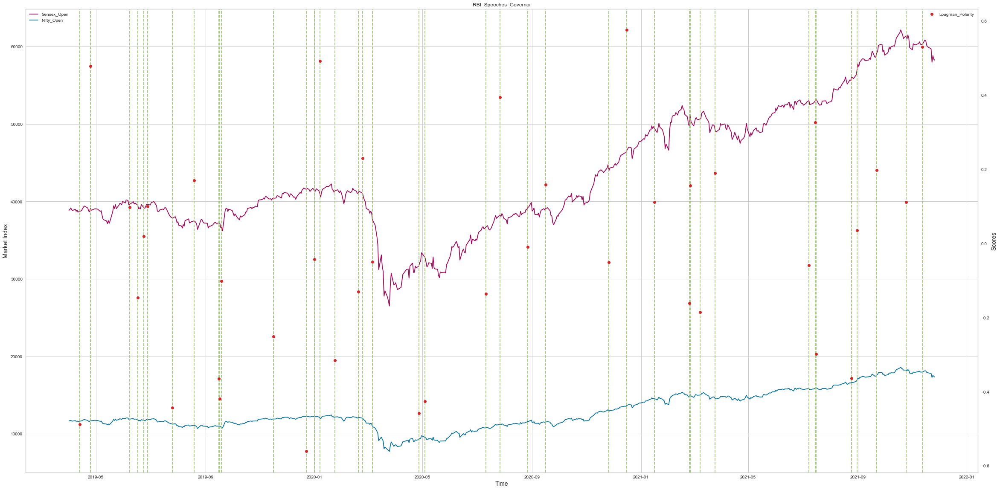

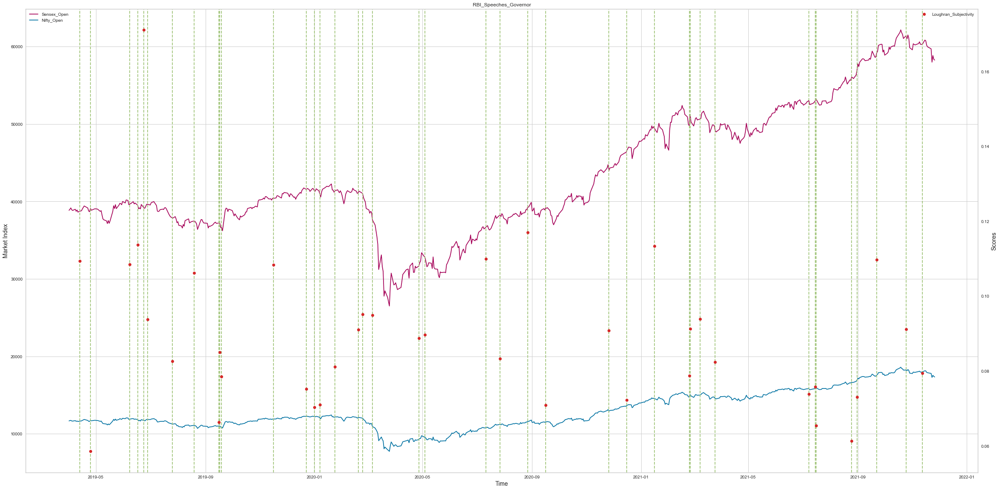

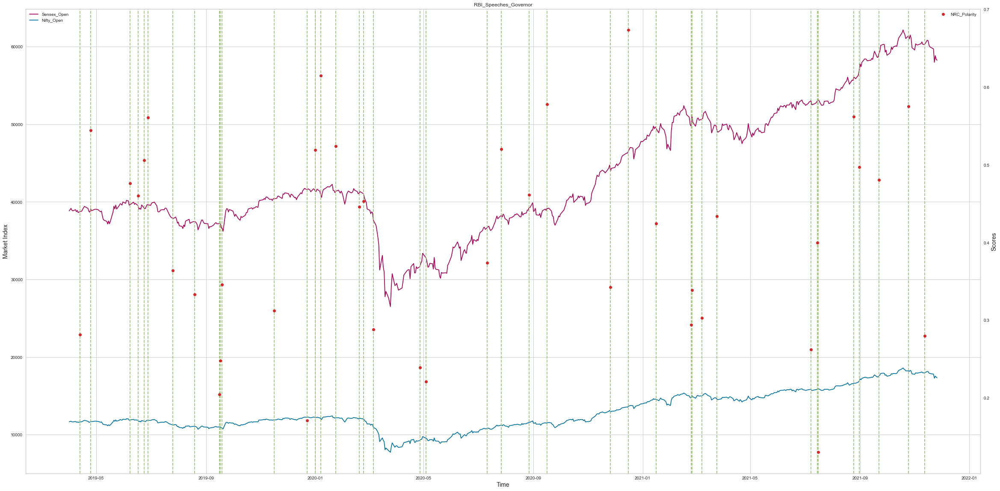

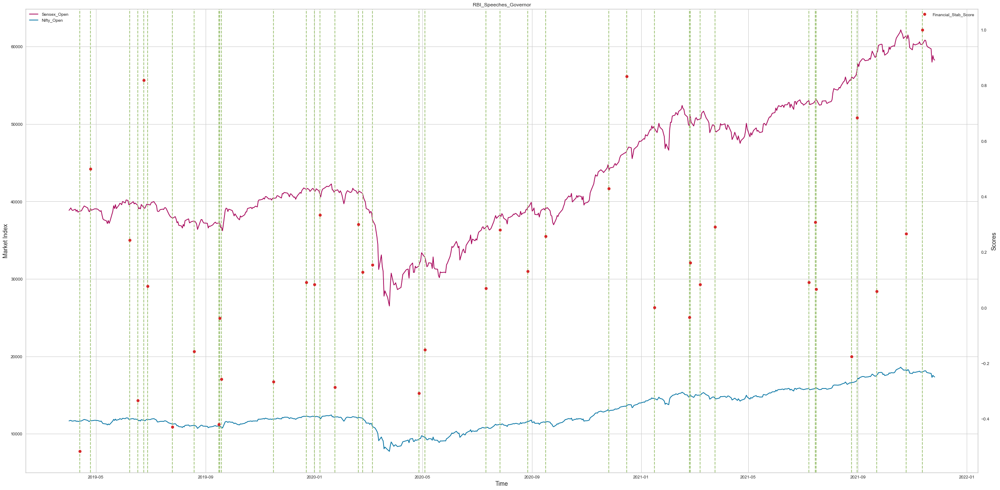

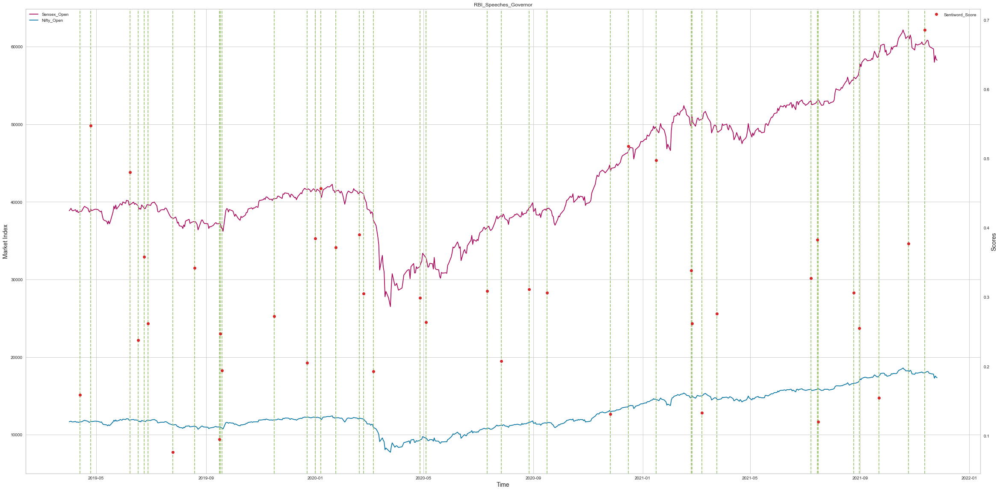

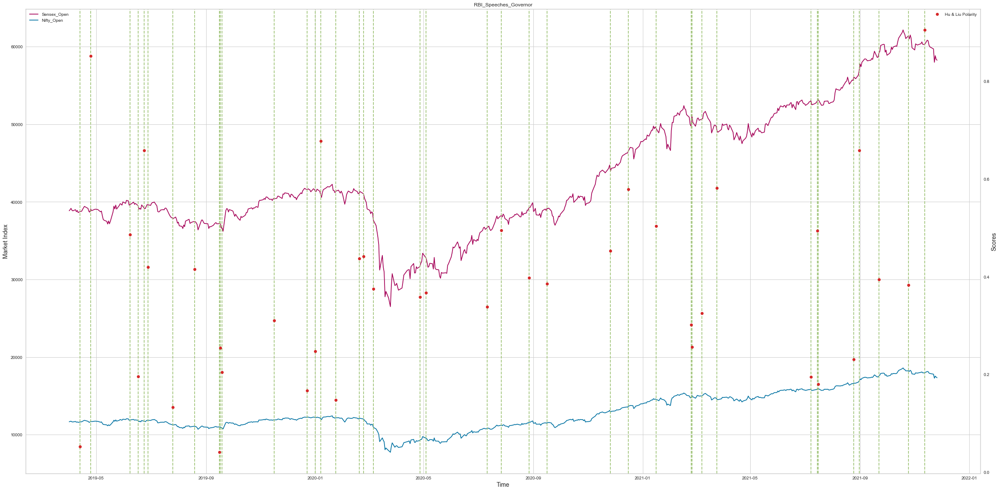

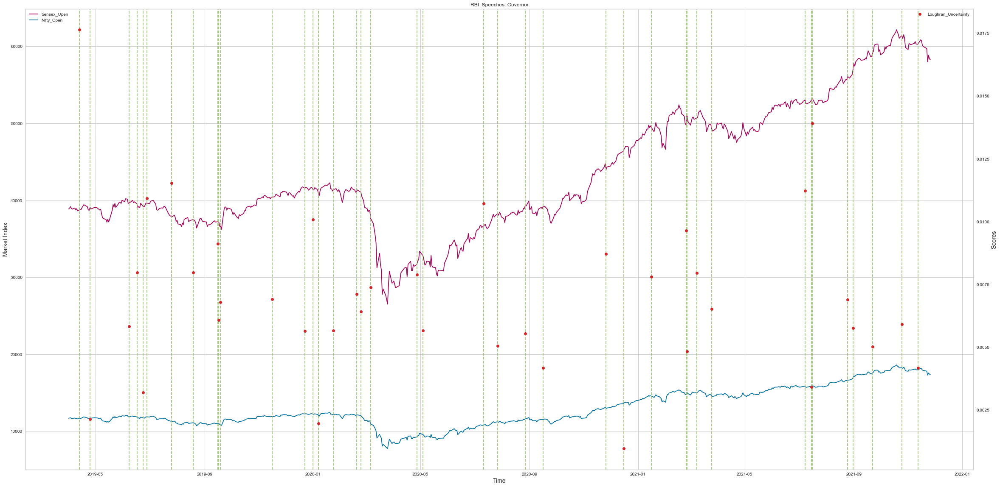

In [101]:
for i in range(2,9,1):
    # setting plot size
    plt.rcParams['figure.figsize'] = 40, 20
    # create figure and axis objects with subplots()
    fig,ax = plt.subplots()
    # make a plot of first y-axis
    ax.plot(bsensedata['Open_BSE'], color='m', label='Sensex_Open')
    ax.plot(bsensedata['Open_NSE'], color='b', label='Nifty_Open')
    # set x-axis label
    ax.set_xlabel("Time",fontsize=14)
    # set y-axis label
    ax.set_ylabel("Market Index",fontsize=14)
    for xc in speeches_date:
        ax.axvline(x=xc, color='g', linestyle='dashed')
    ax.legend(loc=2)
    
    ax2=ax.twinx()
    # make a plot with different y-axis using second axis object
    ax2.plot(speeches_date, score_speeches_merge_date[score_speeches_merge_date.columns[[i]]], color='tab:red', label=score_speeches_merge_date.columns[i], linestyle='None', marker='o')
    ax2.set_ylabel("Scores",fontsize=14)
    ax2.legend(loc=1)
    plt.title('RBI_Speeches_Governor')
    plt.grid()
    a = score_speeches_merge_date.columns[i]+'_RBI_Speeches_gov_Market_Index'+".jpg"
    plt.savefig(a)
    plt.show()

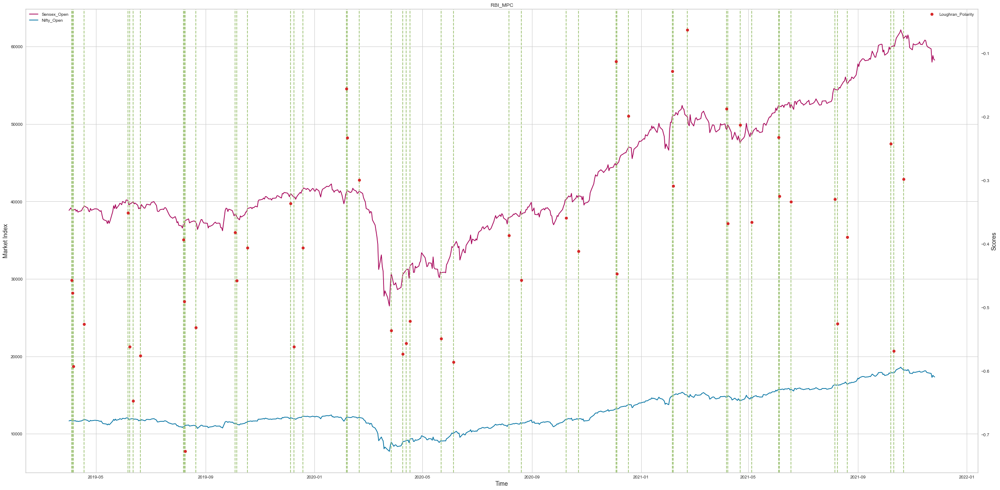

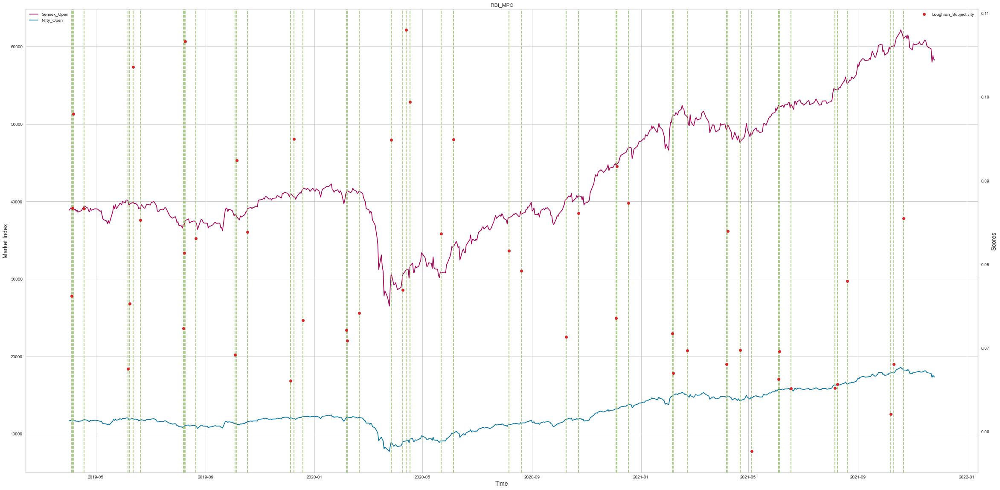

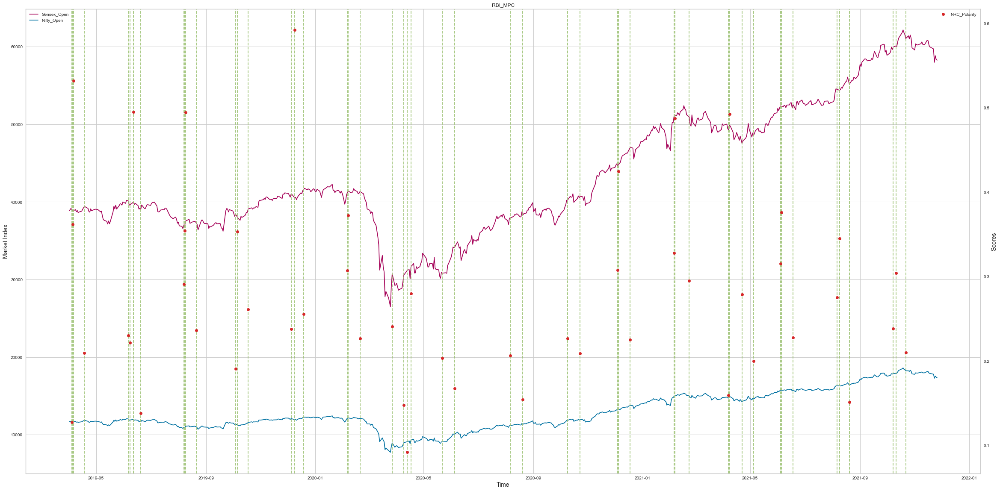

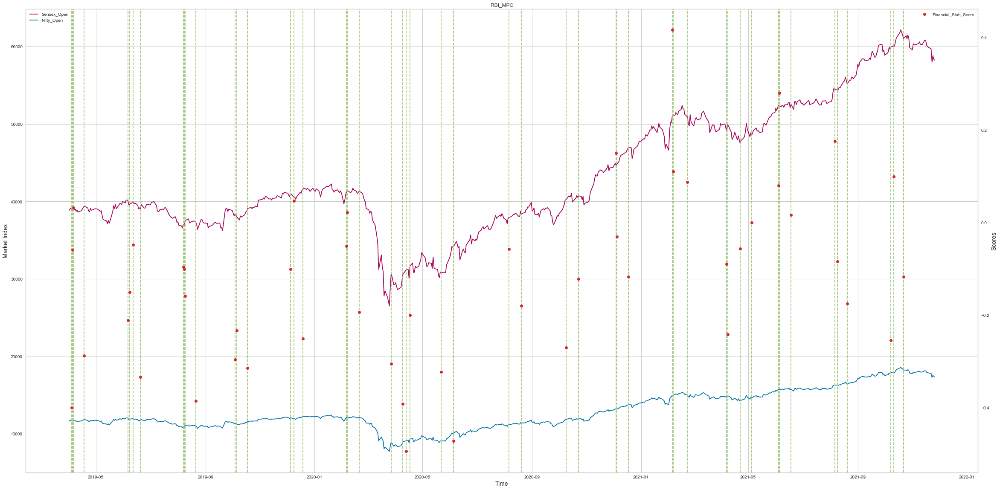

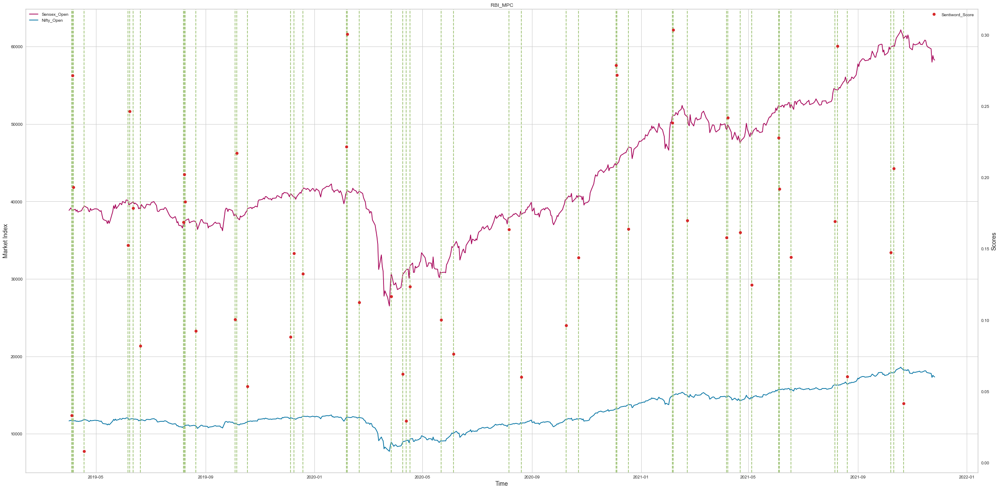

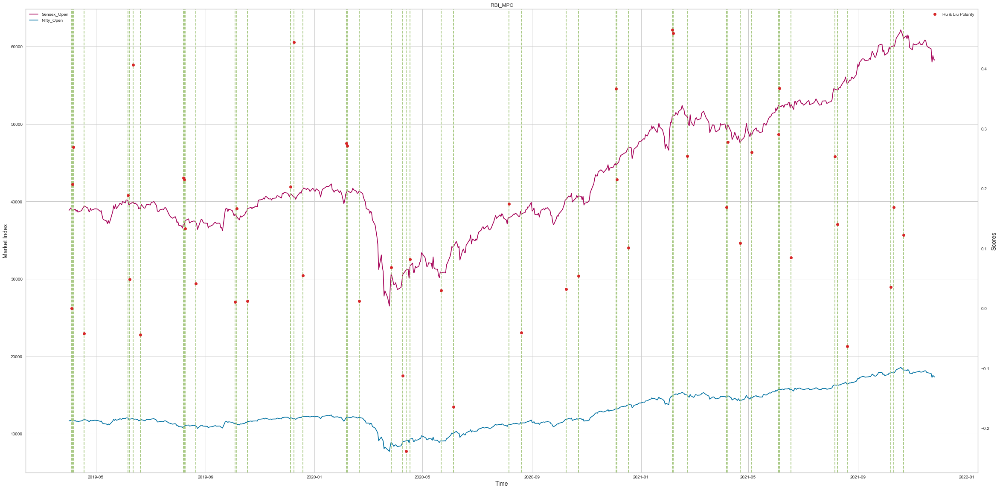

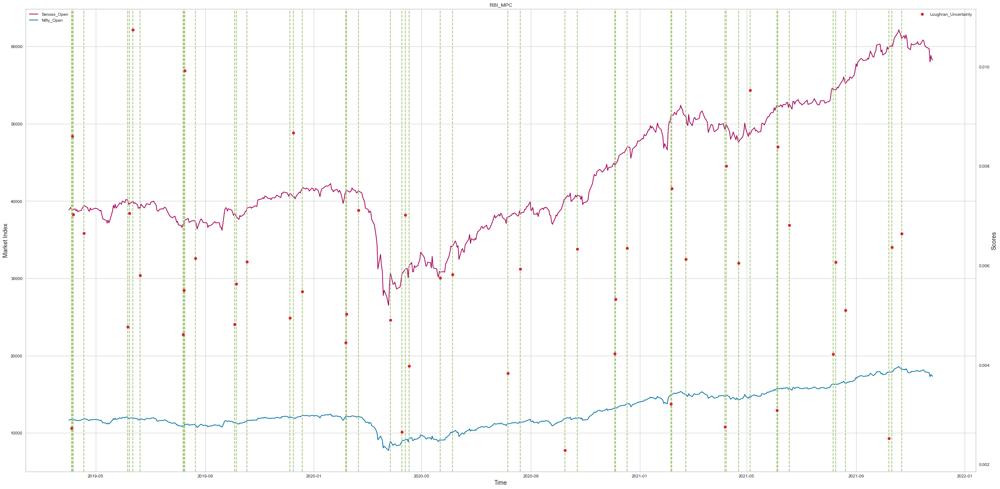

In [102]:
for i in range(2,9,1):
    # setting plot size
    plt.rcParams['figure.figsize'] = 40, 20
    # create figure and axis objects with subplots()
    fig,ax = plt.subplots()
    # make a plot of first y-axis
    ax.plot(bsensedata['Open_BSE'], color='m', label='Sensex_Open')
    ax.plot(bsensedata['Open_NSE'], color='b', label='Nifty_Open')
    # set x-axis label
    ax.set_xlabel("Time",fontsize=14)
    # set y-axis label
    ax.set_ylabel("Market Index",fontsize=14)
    for xc in mpc_date:
        ax.axvline(x=xc, color='g', linestyle='dashed')
    ax.legend(loc=2)
    
    ax2=ax.twinx()
    # make a plot with different y-axis using second axis object
    ax2.plot(mpc_date, score_mpc_merge_date[score_mpc_merge_date.columns[[i]]], color='tab:red', label=score_mpc_merge_date.columns[i], linestyle='None', marker='o')
    ax2.set_ylabel("Scores",fontsize=14)
    ax2.legend(loc=1)
    plt.title('RBI_MPC')
    plt.grid()
    a = score_mpc_merge_date.columns[i]+'_RBI_MPC_Market_Index'+".jpg"
    plt.savefig(a)
    plt.show()

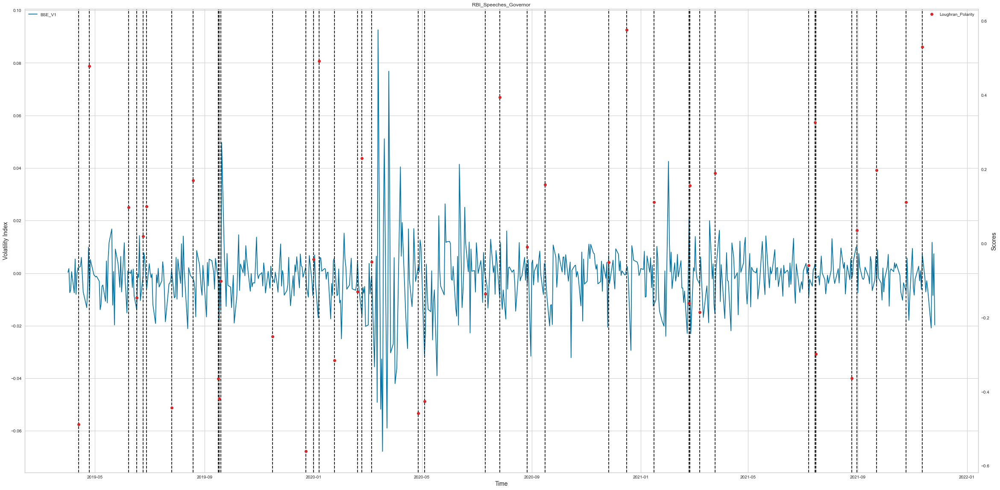

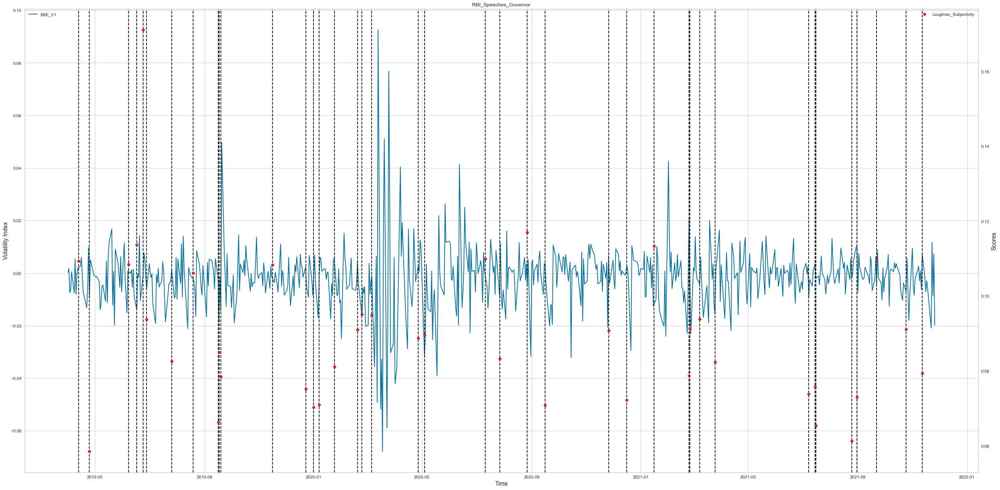

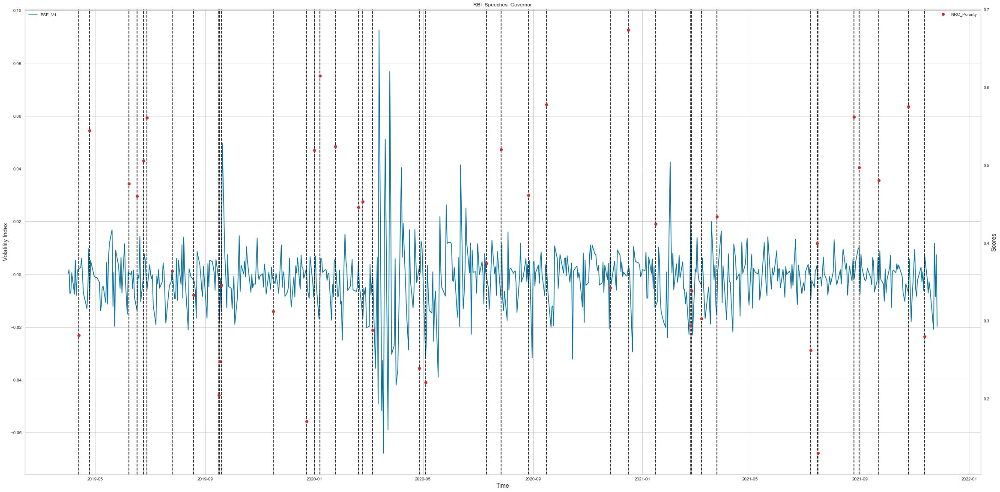

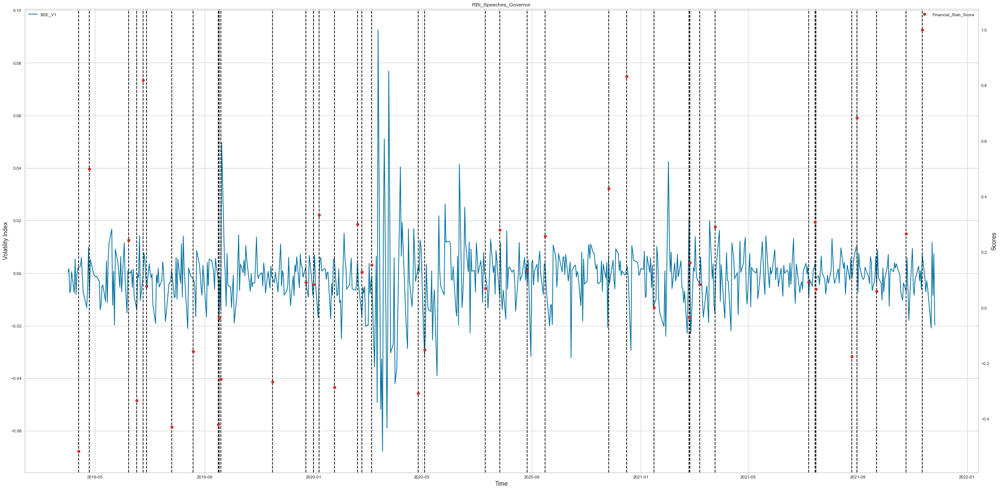

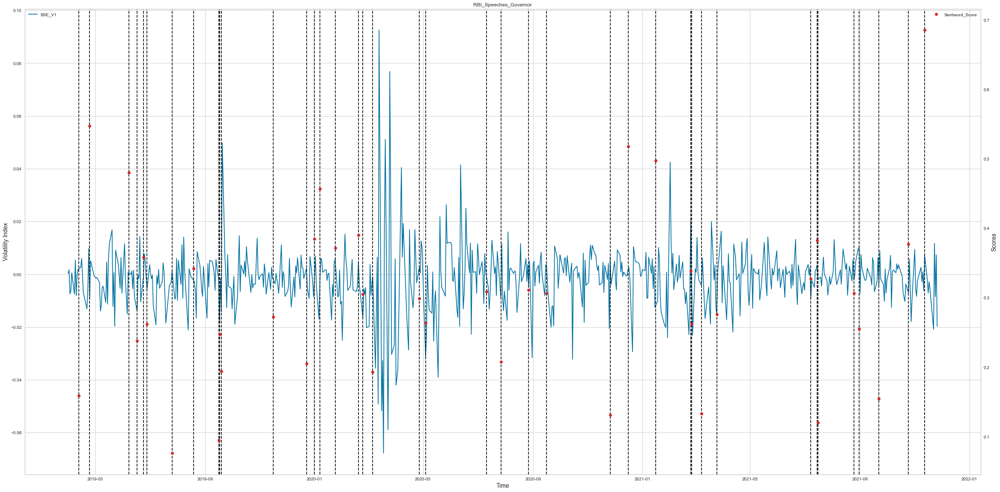

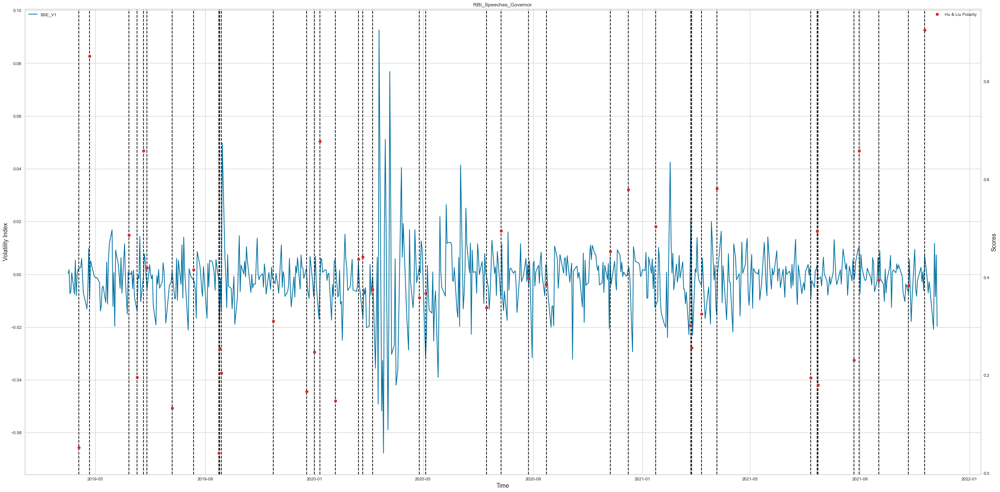

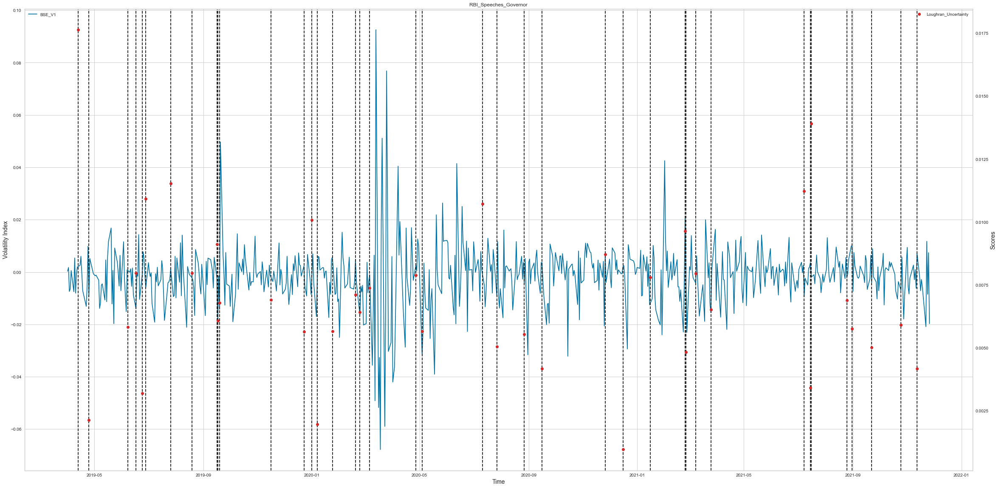

In [65]:
for i in range(2,9,1):
    # setting plot size
    plt.rcParams['figure.figsize'] = 40, 20
    # create figure and axis objects with subplots()
    fig,ax = plt.subplots()
    # make a plot of first y-axis
    ax.plot(bsensedata['BSE_V1'], color='b', label='BSE_V1')
    # set x-axis label
    ax.set_xlabel("Time",fontsize=14)
    # set y-axis label
    ax.set_ylabel("Volatility Index",fontsize=14)
    for xc in speeches_date:
        ax.axvline(x=xc, color='k', linestyle='dashed')
    ax.legend(loc=2)
    
    ax2=ax.twinx()
    # make a plot with different y-axis using second axis object
    ax2.plot(speeches_date, score_speeches_merge_date[score_speeches_merge_date.columns[[i]]], color='tab:red', label=score_speeches_merge_date.columns[i], linestyle='None', marker='o')
    ax2.set_ylabel("Scores",fontsize=14)
    ax2.legend(loc=1)
    plt.title('RBI_Speeches_Governor')
    plt.grid()
    a = score_speeches_merge_date.columns[i]+'_RBI_Speeches_gov_Volatility_Index_BSE_V1'+".jpg"
    plt.savefig(a)
    plt.show()

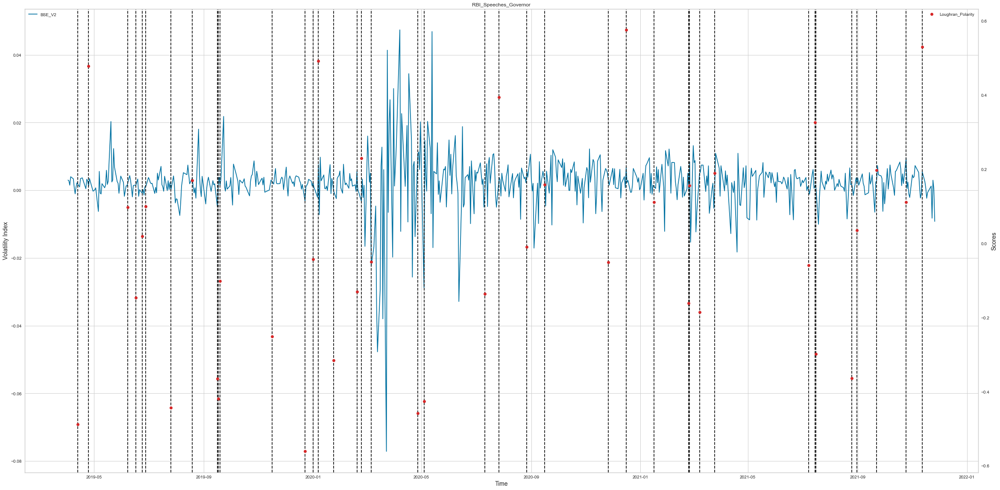

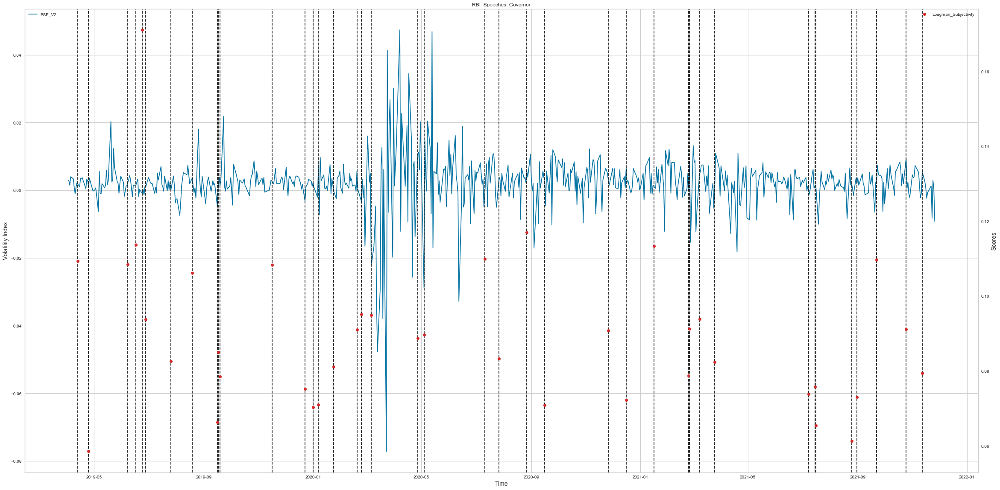

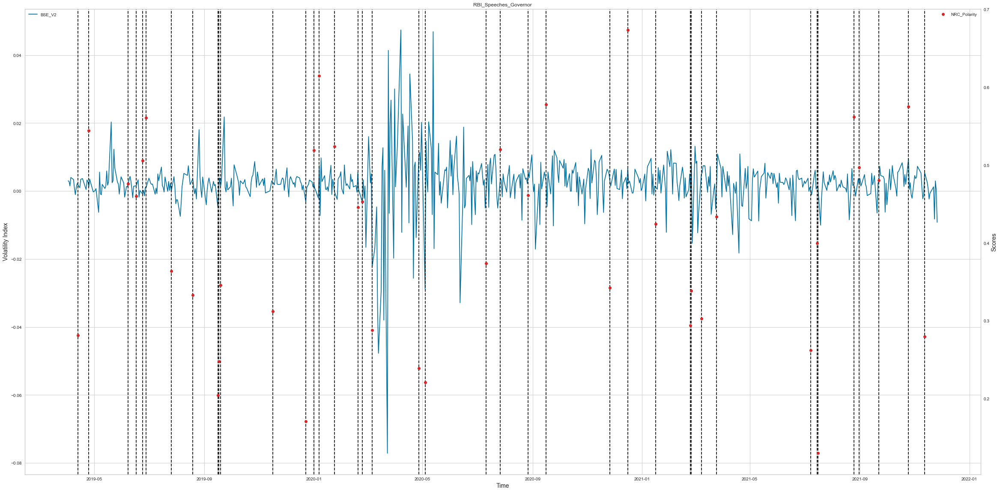

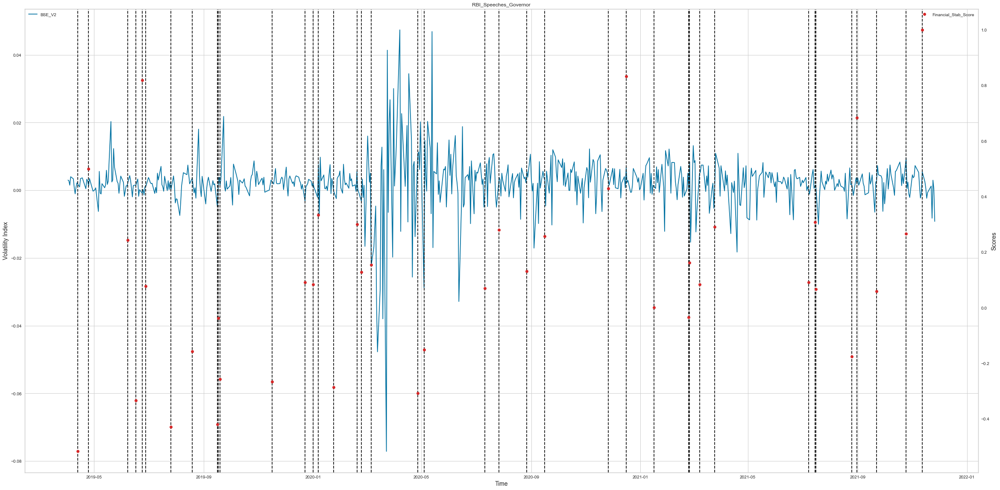

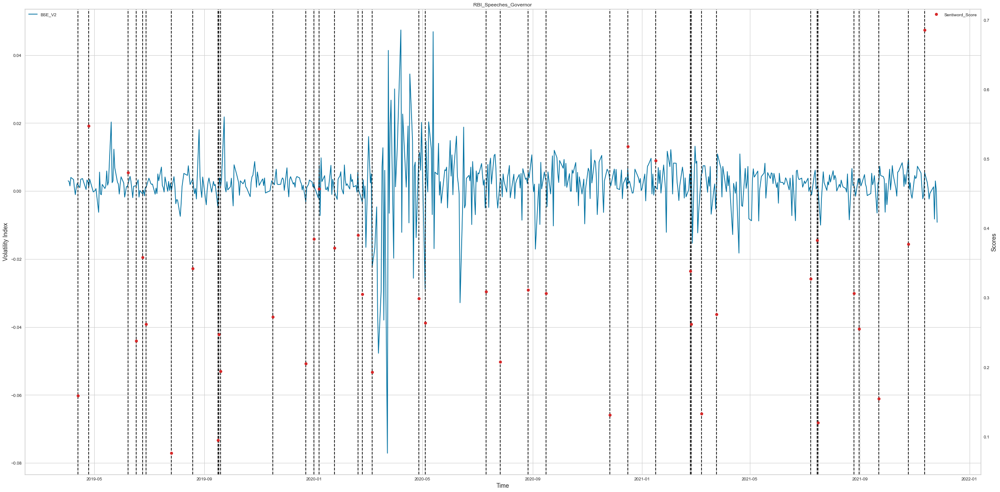

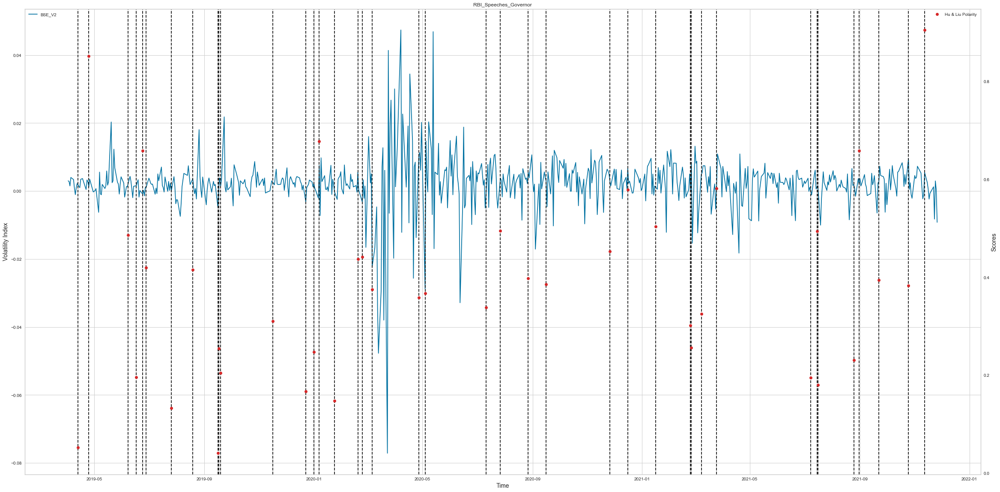

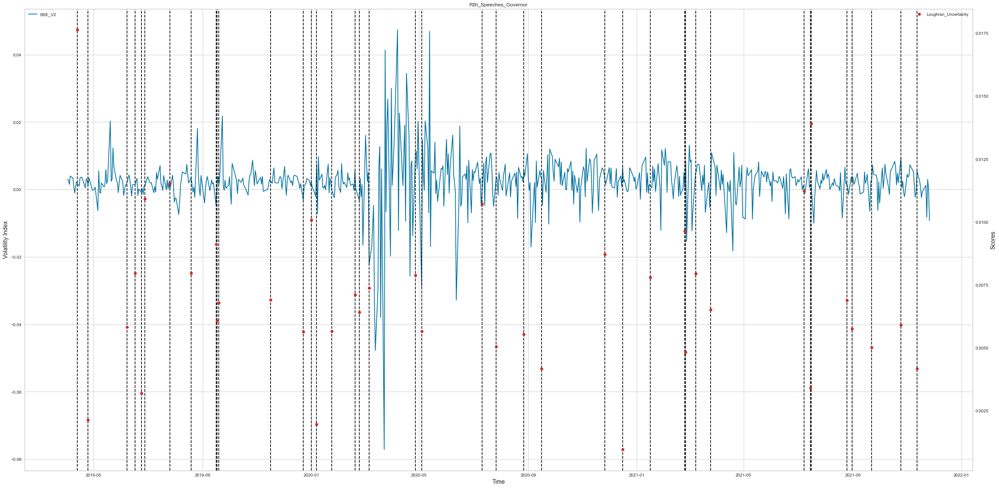

In [66]:
for i in range(2,9,1):
    # setting plot size
    plt.rcParams['figure.figsize'] = 40, 20
    # create figure and axis objects with subplots()
    fig,ax = plt.subplots()
    # make a plot of first y-axis
    ax.plot(bsensedata['BSE_V2'], color='b', label='BSE_V2')
    # set x-axis label
    ax.set_xlabel("Time",fontsize=14)
    # set y-axis label
    ax.set_ylabel("Volatility Index",fontsize=14)
    for xc in speeches_date:
        ax.axvline(x=xc, color='k', linestyle='dashed')
    ax.legend(loc=2)
    
    ax2=ax.twinx()
    # make a plot with different y-axis using second axis object
    ax2.plot(speeches_date, score_speeches_merge_date[score_speeches_merge_date.columns[[i]]], color='tab:red', label=score_speeches_merge_date.columns[i], linestyle='None', marker='o')
    ax2.set_ylabel("Scores",fontsize=14)
    ax2.legend(loc=1)
    plt.title('RBI_Speeches_Governor')
    plt.grid()
    a = score_speeches_merge_date.columns[i]+'_RBI_Speeches_gov_Volatility_Index_BSE_V2'+".jpg"
    plt.savefig(a)
    plt.show()

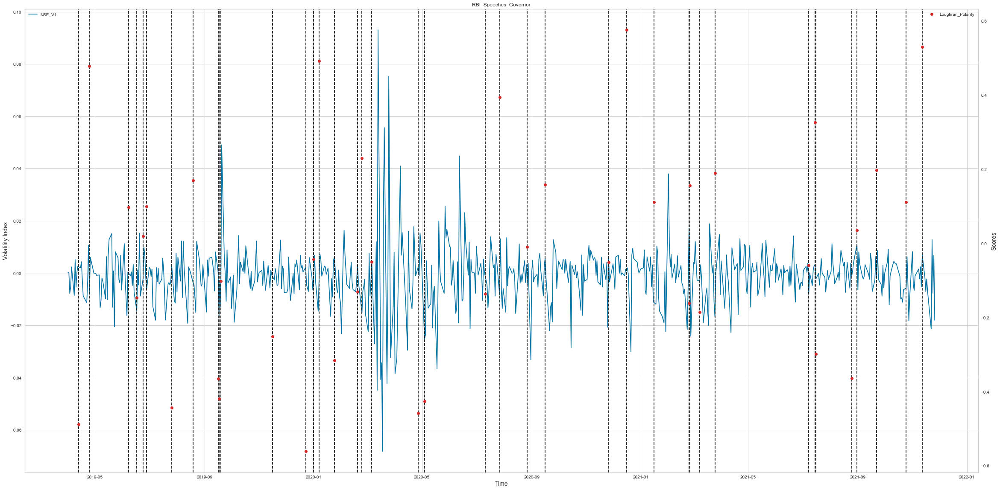

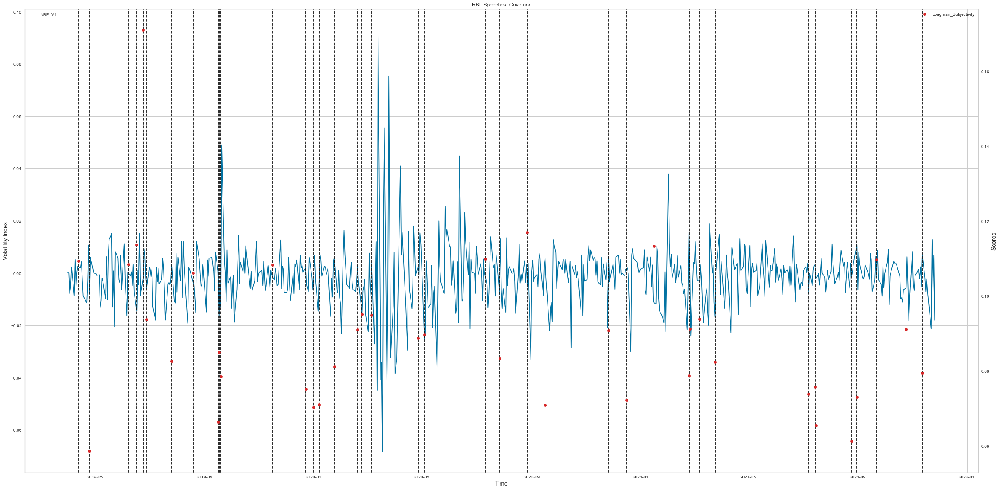

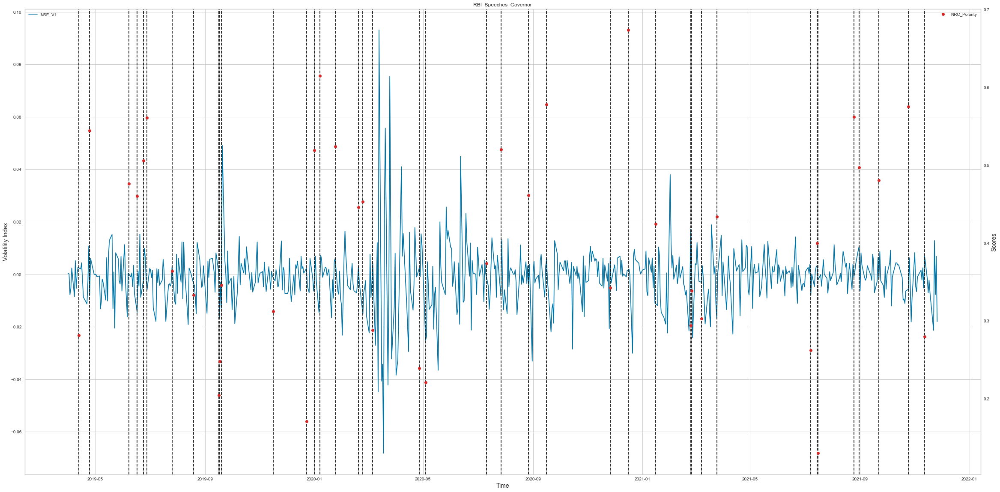

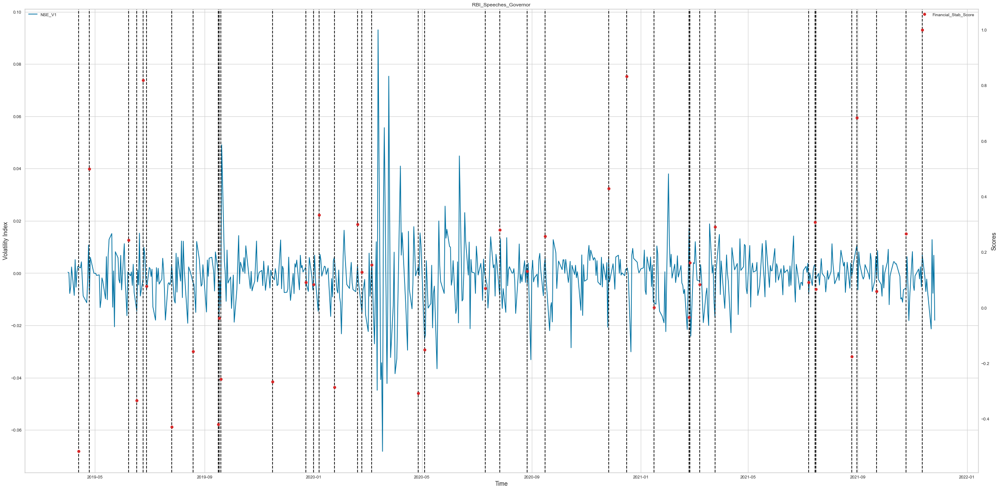

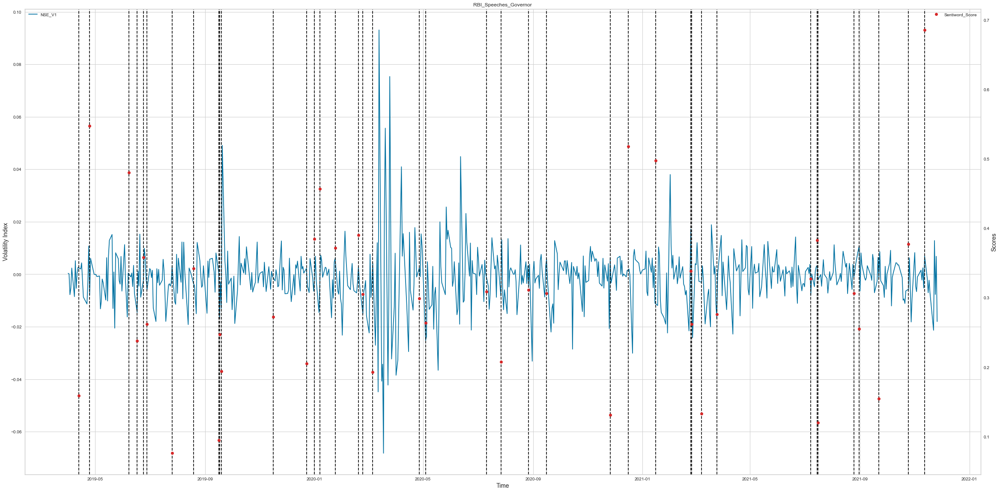

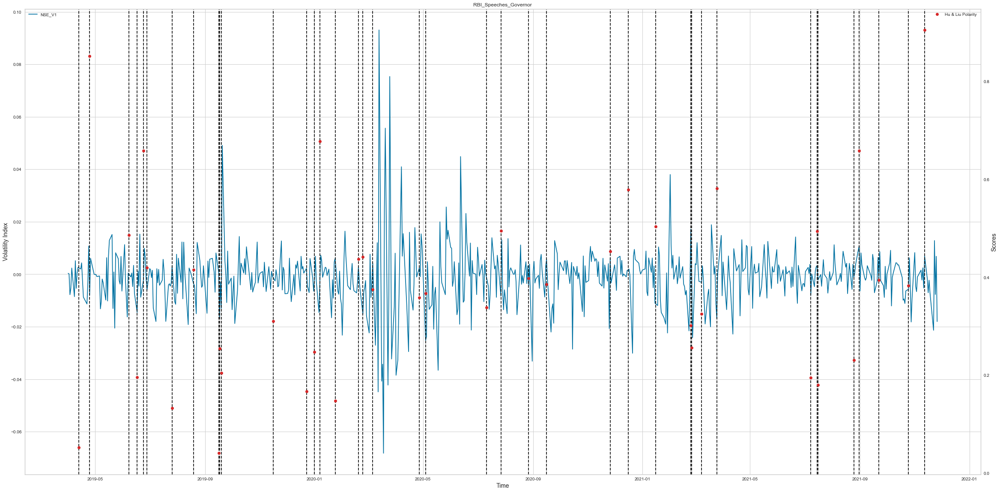

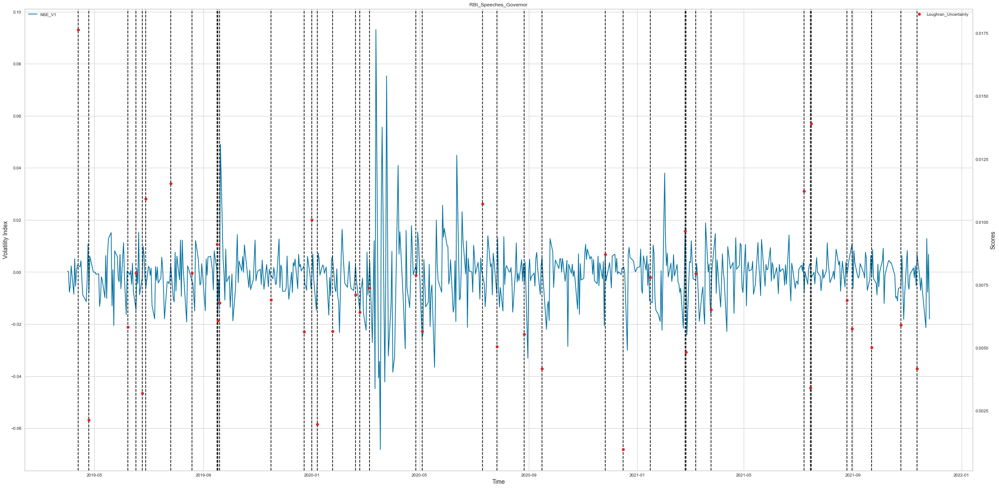

In [67]:
for i in range(2,9,1):
    # setting plot size
    plt.rcParams['figure.figsize'] = 40, 20
    # create figure and axis objects with subplots()
    fig,ax = plt.subplots()
    # make a plot of first y-axis
    ax.plot(bsensedata['NSE_V1'], color='b', label='NSE_V1')
    # set x-axis label
    ax.set_xlabel("Time",fontsize=14)
    # set y-axis label
    ax.set_ylabel("Volatility Index",fontsize=14)
    for xc in speeches_date:
        ax.axvline(x=xc, color='k', linestyle='dashed')
    ax.legend(loc=2)
    
    ax2=ax.twinx()
    # make a plot with different y-axis using second axis object
    ax2.plot(speeches_date, score_speeches_merge_date[score_speeches_merge_date.columns[[i]]], color='tab:red', label=score_speeches_merge_date.columns[i], linestyle='None', marker='o')
    ax2.set_ylabel("Scores",fontsize=14)
    ax2.legend(loc=1)
    plt.title('RBI_Speeches_Governor')
    plt.grid()
    a = score_speeches_merge_date.columns[i]+'_RBI_Speeches_gov_Volatility_Index_NSE_V1'+".jpg"
    plt.savefig(a)
    plt.show()

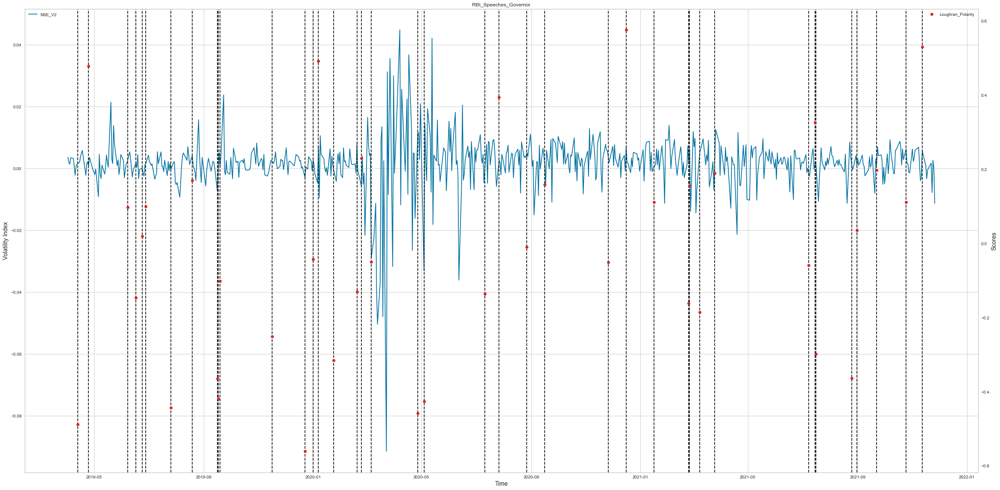

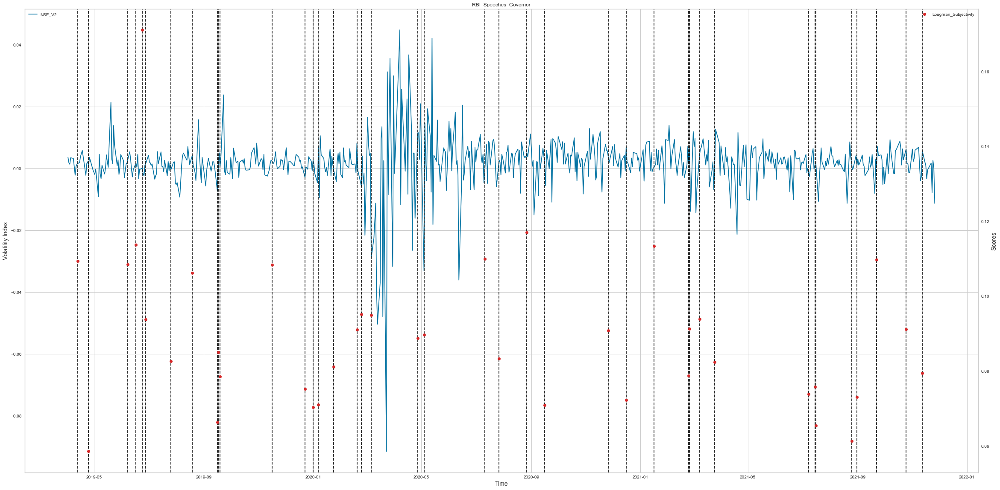

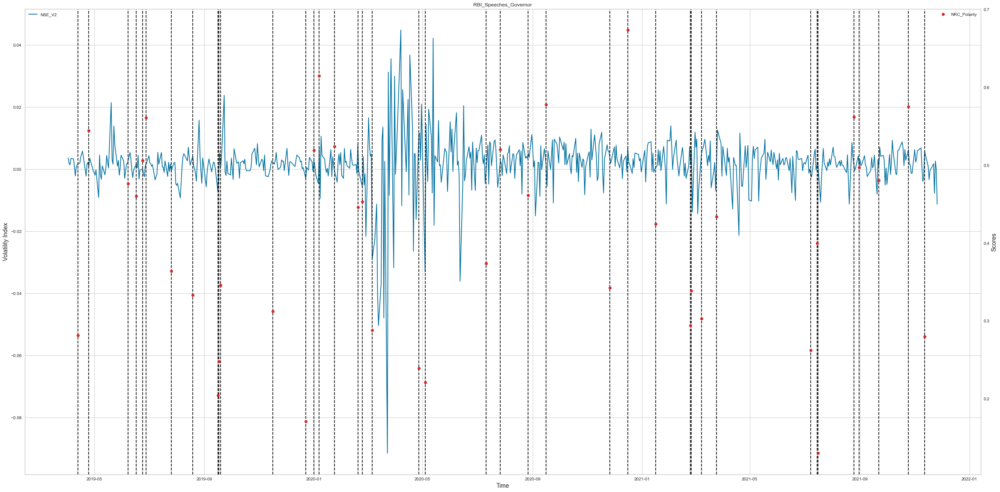

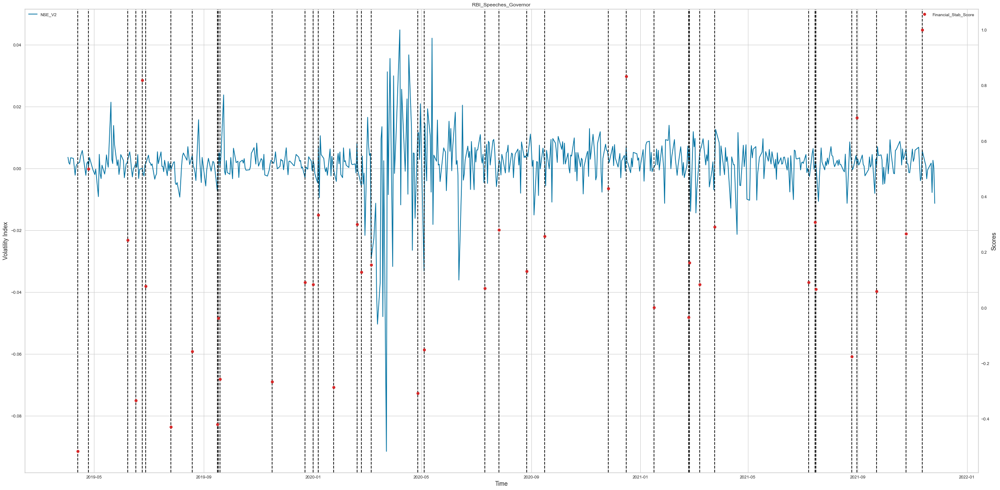

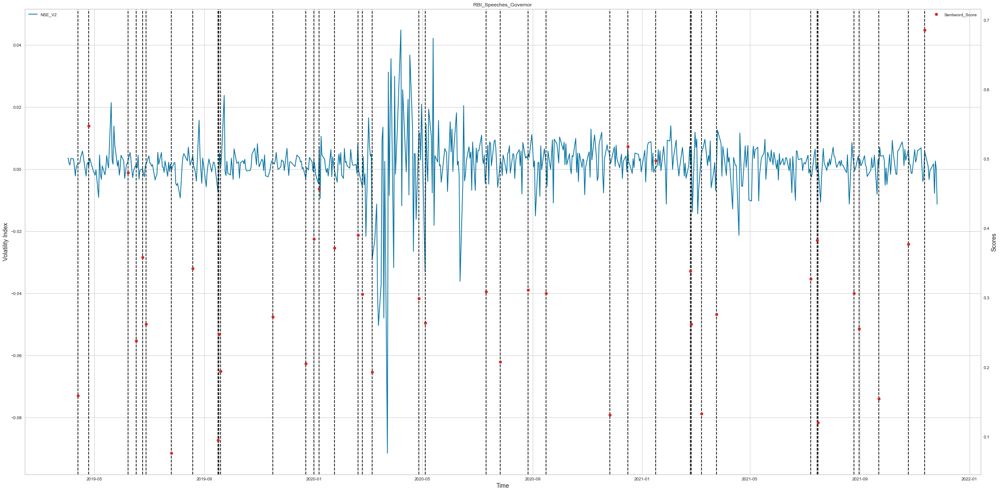

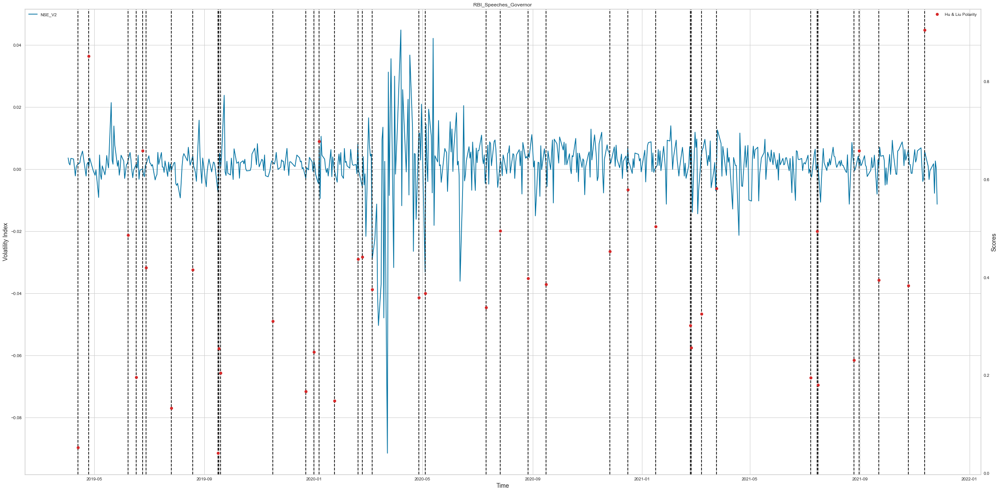

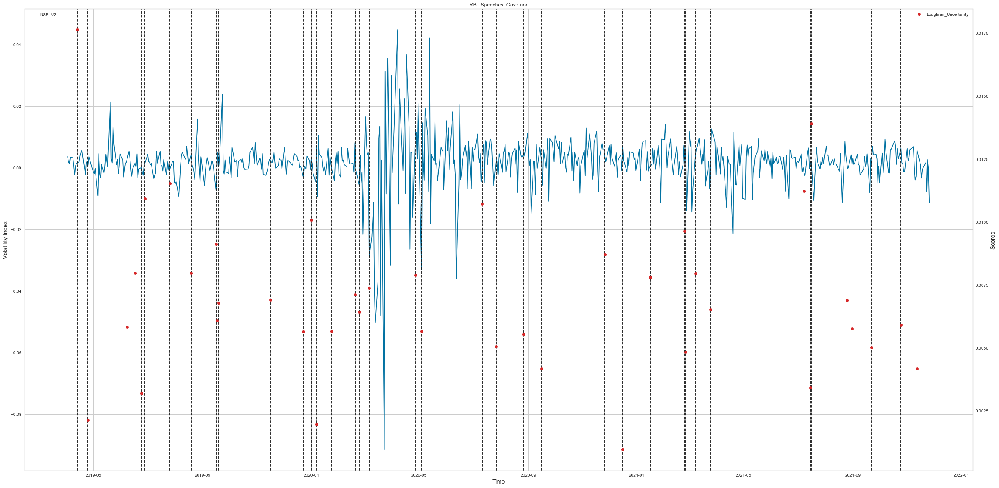

In [68]:
for i in range(2,9,1):
    # setting plot size
    plt.rcParams['figure.figsize'] = 40, 20
    # create figure and axis objects with subplots()
    fig,ax = plt.subplots()
    # make a plot of first y-axis
    ax.plot(bsensedata['NSE_V2'], color='b', label='NSE_V2')
    # set x-axis label
    ax.set_xlabel("Time",fontsize=14)
    # set y-axis label
    ax.set_ylabel("Volatility Index",fontsize=14)
    for xc in speeches_date:
        ax.axvline(x=xc, color='k', linestyle='dashed')
    ax.legend(loc=2)
    
    ax2=ax.twinx()
    # make a plot with different y-axis using second axis object
    ax2.plot(speeches_date, score_speeches_merge_date[score_speeches_merge_date.columns[[i]]], color='tab:red', label=score_speeches_merge_date.columns[i], linestyle='None', marker='o')
    ax2.set_ylabel("Scores",fontsize=14)
    ax2.legend(loc=1)
    plt.title('RBI_Speeches_Governor')
    plt.grid()
    a = score_speeches_merge_date.columns[i]+'_RBI_Speeches_gov_Volatility_Index_NSE_V2'+".jpg"
    plt.savefig(a)
    plt.show()

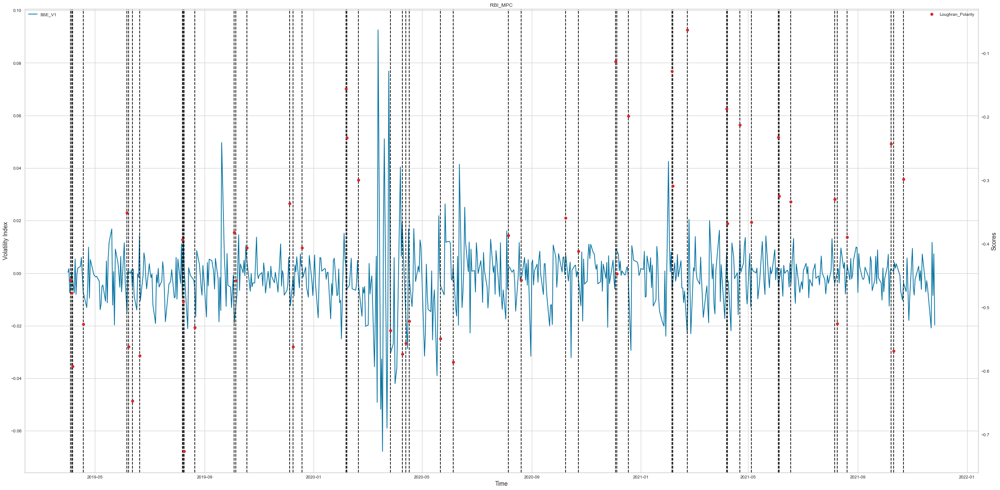

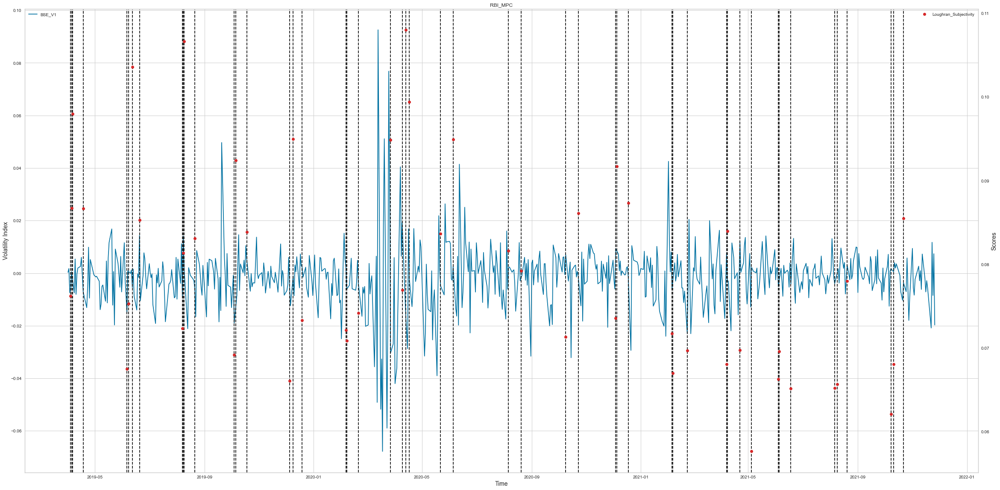

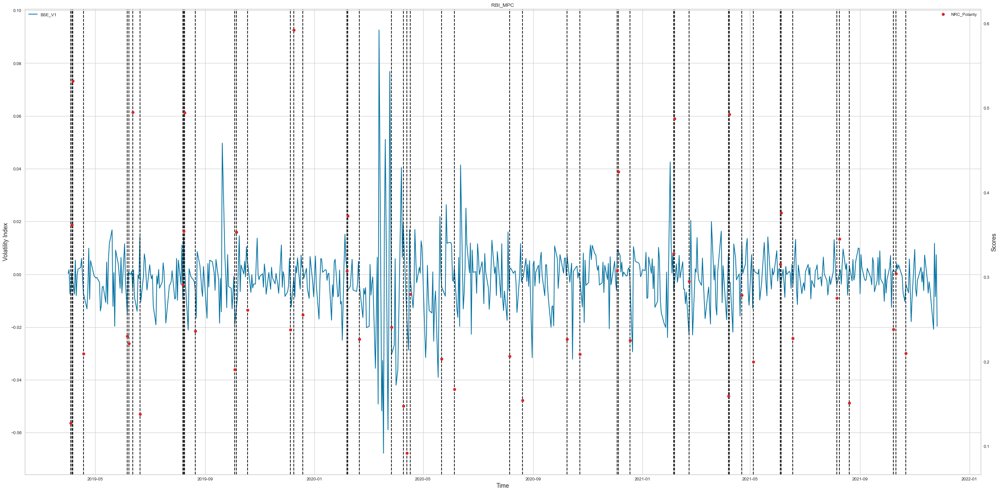

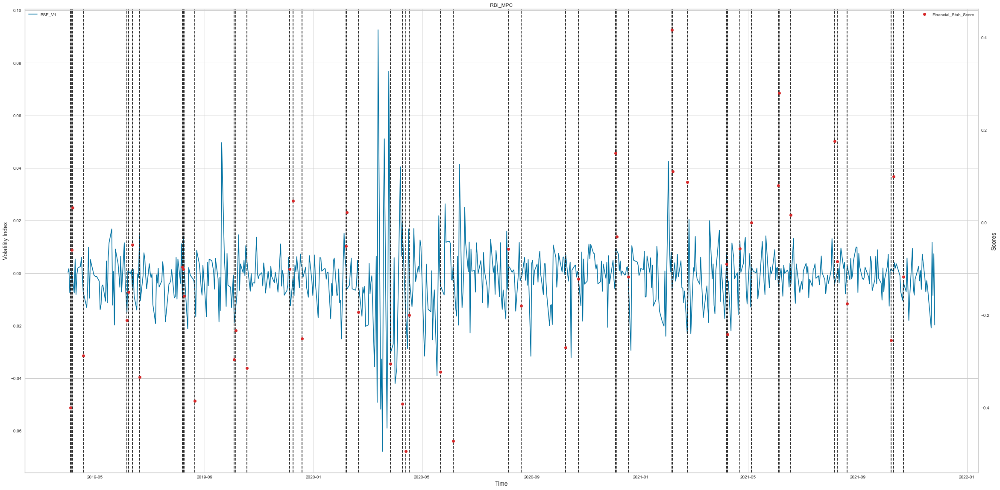

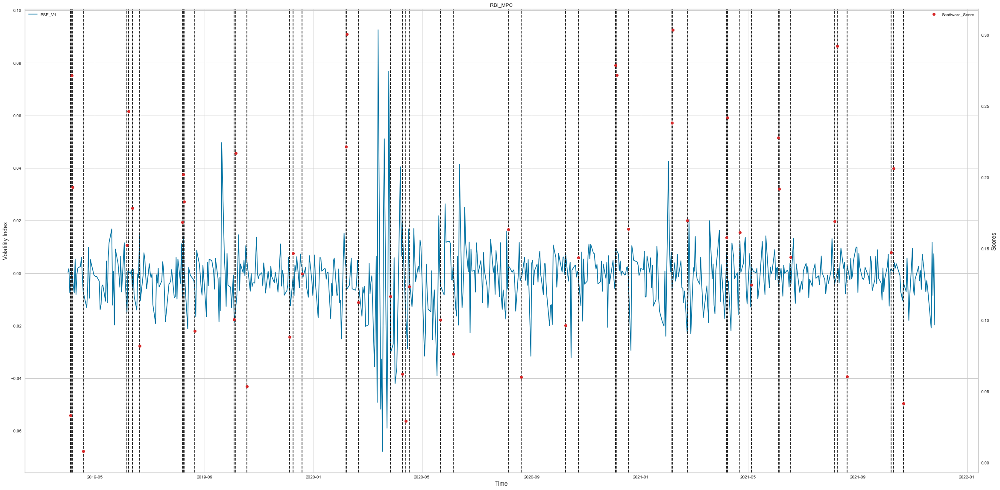

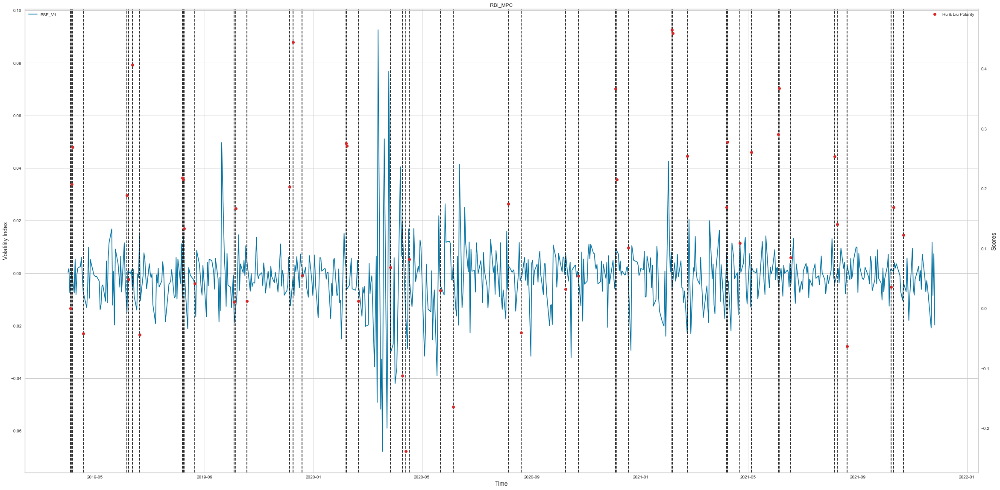

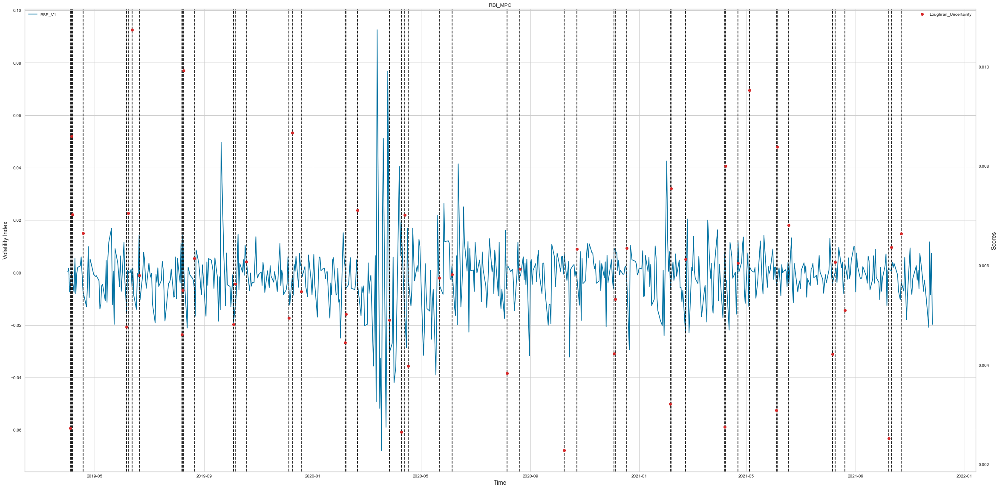

In [69]:
for i in range(2,9,1):
    # setting plot size
    plt.rcParams['figure.figsize'] = 40, 20
    # create figure and axis objects with subplots()
    fig,ax = plt.subplots()
    # make a plot of first y-axis
    ax.plot(bsensedata['BSE_V1'], color='b', label='BSE_V1')
    # set x-axis label
    ax.set_xlabel("Time",fontsize=14)
    # set y-axis label
    ax.set_ylabel("Volatility Index",fontsize=14)
    for xc in mpc_date:
        ax.axvline(x=xc, color='k', linestyle='dashed')
    ax.legend(loc=2)
    
    ax2=ax.twinx()
    # make a plot with different y-axis using second axis object
    ax2.plot(mpc_date, score_mpc_merge_date[score_mpc_merge_date.columns[[i]]], color='tab:red', label=score_mpc_merge_date.columns[i], linestyle='None', marker='o')
    ax2.set_ylabel("Scores",fontsize=14)
    ax2.legend(loc=1)
    plt.title('RBI_MPC')
    plt.grid()
    a = score_mpc_merge_date.columns[i]+'_RBI_MPC_Volatility_Index_BSE_V1'+".jpg"
    plt.savefig(a)
    plt.show()

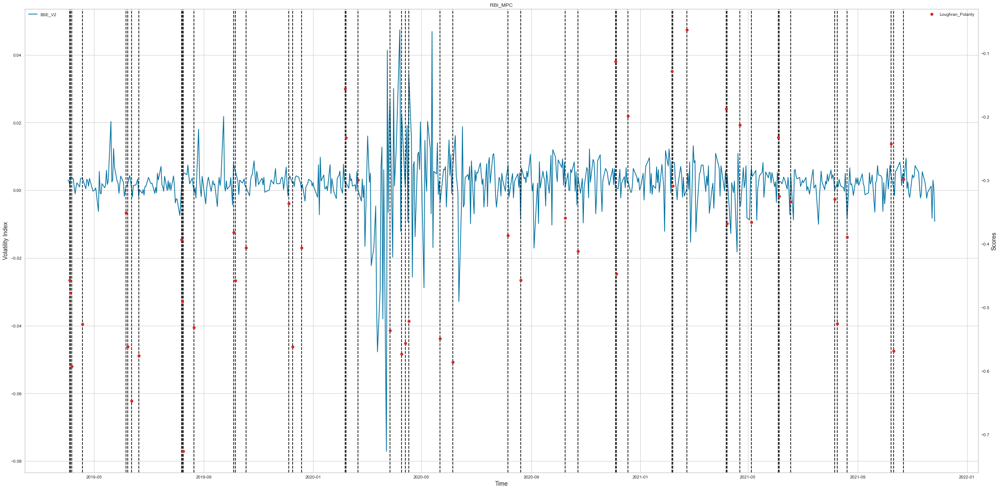

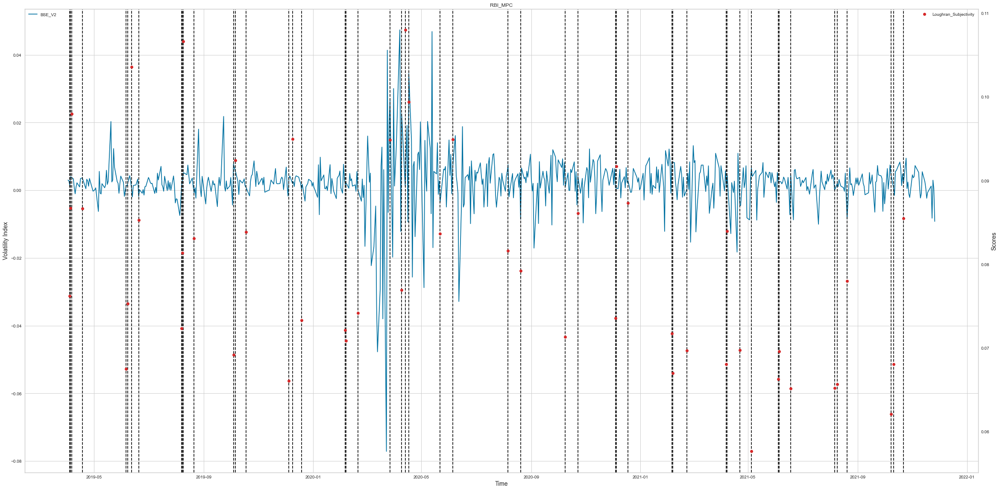

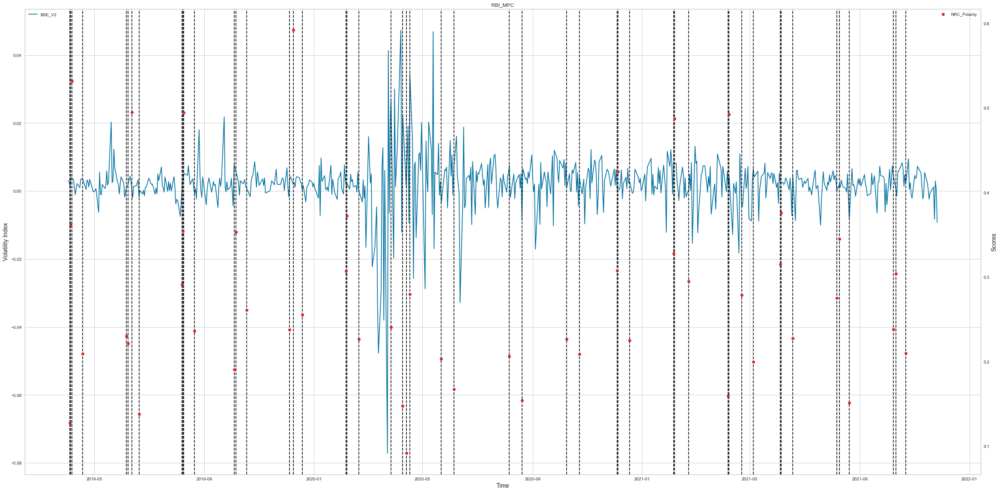

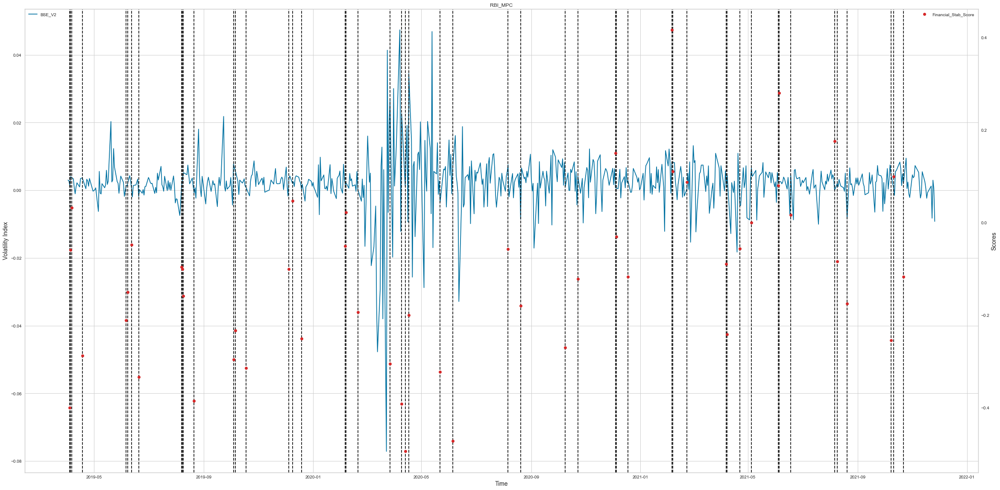

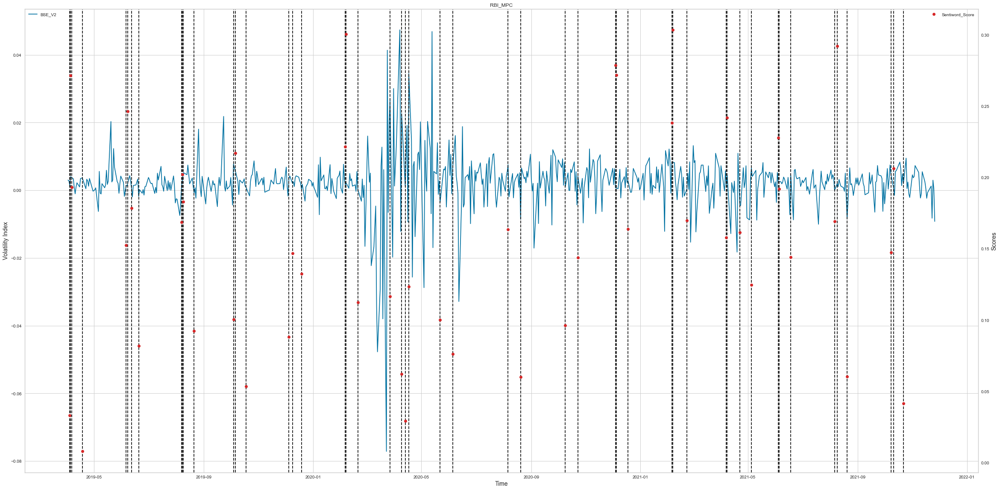

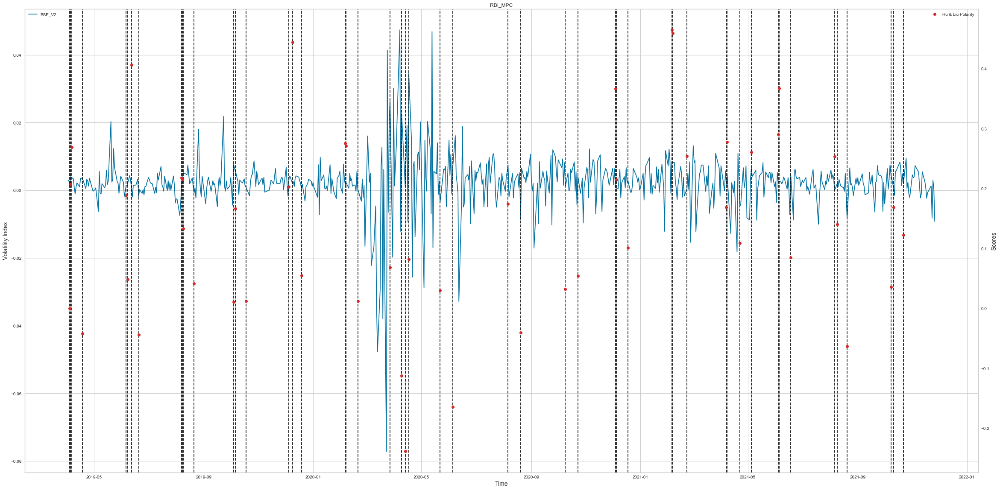

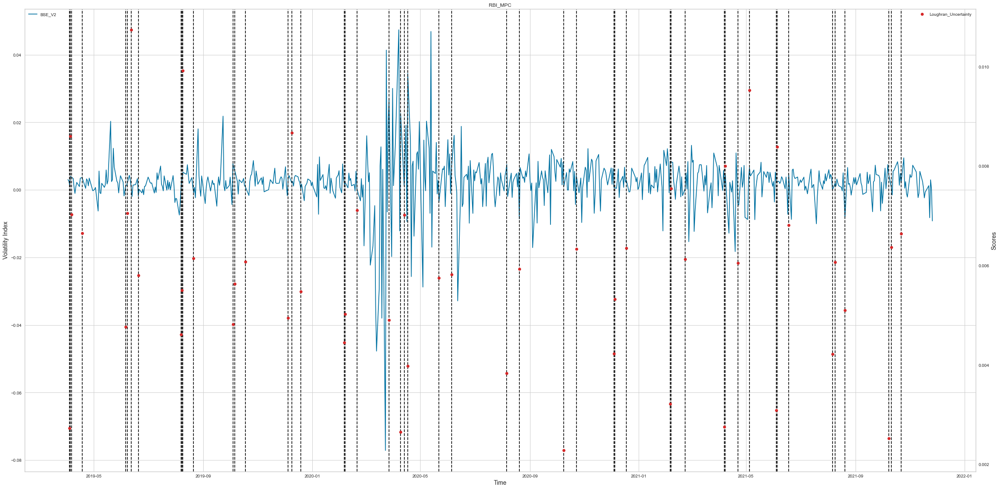

In [70]:
for i in range(2,9,1):
    # setting plot size
    plt.rcParams['figure.figsize'] = 40, 20
    # create figure and axis objects with subplots()
    fig,ax = plt.subplots()
    # make a plot of first y-axis
    ax.plot(bsensedata['BSE_V2'], color='b', label='BSE_V2')
    # set x-axis label
    ax.set_xlabel("Time",fontsize=14)
    # set y-axis label
    ax.set_ylabel("Volatility Index",fontsize=14)
    for xc in mpc_date:
        ax.axvline(x=xc, color='k', linestyle='dashed')
    ax.legend(loc=2)
    
    ax2=ax.twinx()
    # make a plot with different y-axis using second axis object
    ax2.plot(mpc_date, score_mpc_merge_date[score_mpc_merge_date.columns[[i]]], color='tab:red', label=score_mpc_merge_date.columns[i], linestyle='None', marker='o')
    ax2.set_ylabel("Scores",fontsize=14)
    ax2.legend(loc=1)
    plt.title('RBI_MPC')
    plt.grid()
    a = score_mpc_merge_date.columns[i]+'_RBI_MPC_Volatility_Index_BSE_V2'+".jpg"
    plt.savefig(a)
    plt.show()

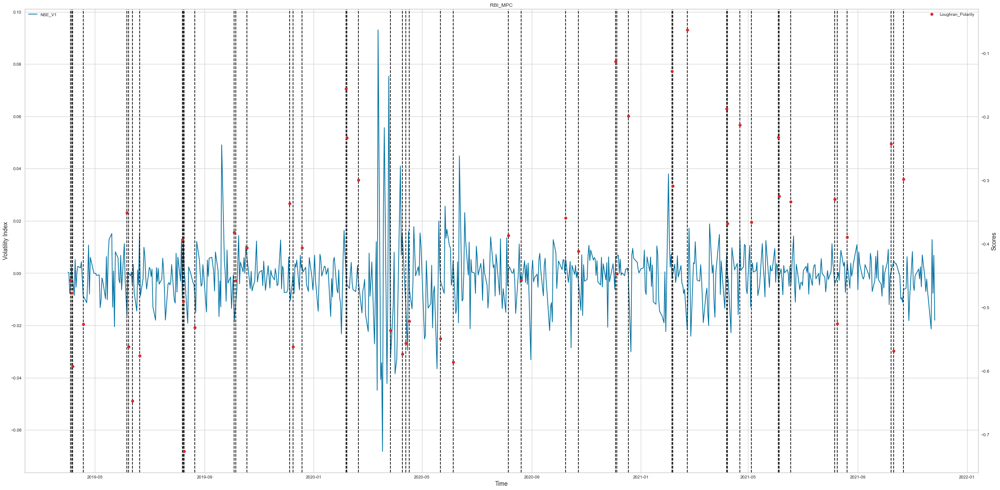

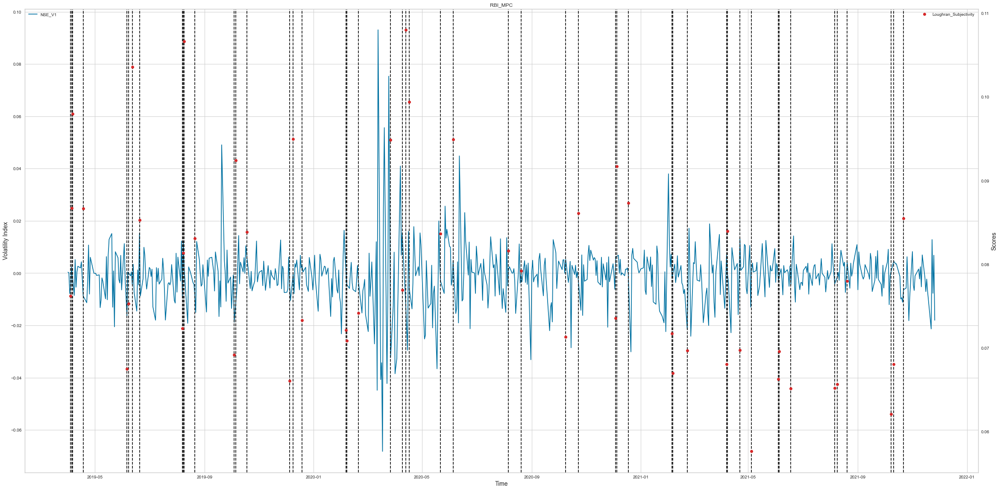

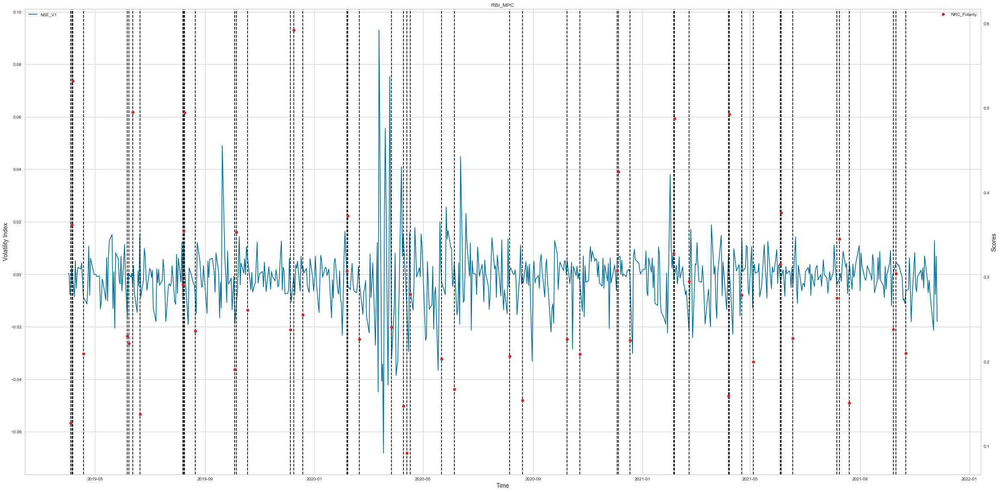

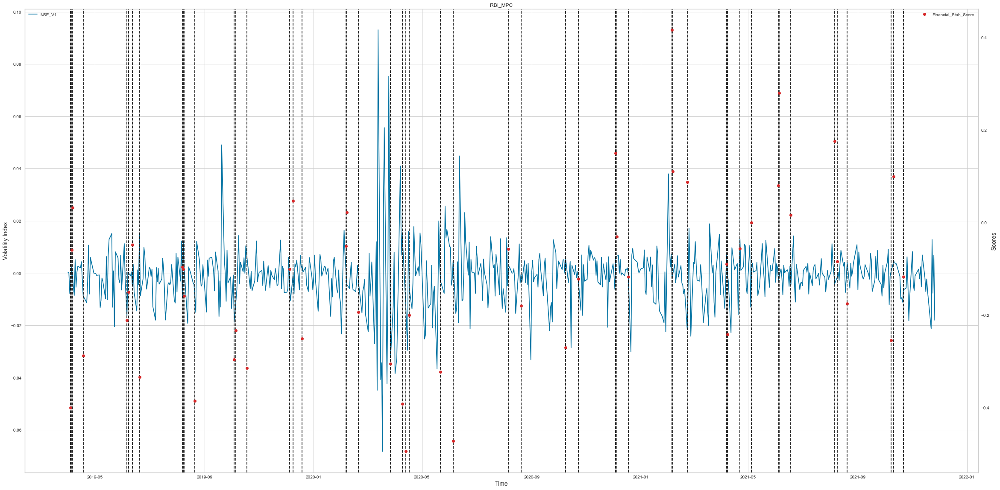

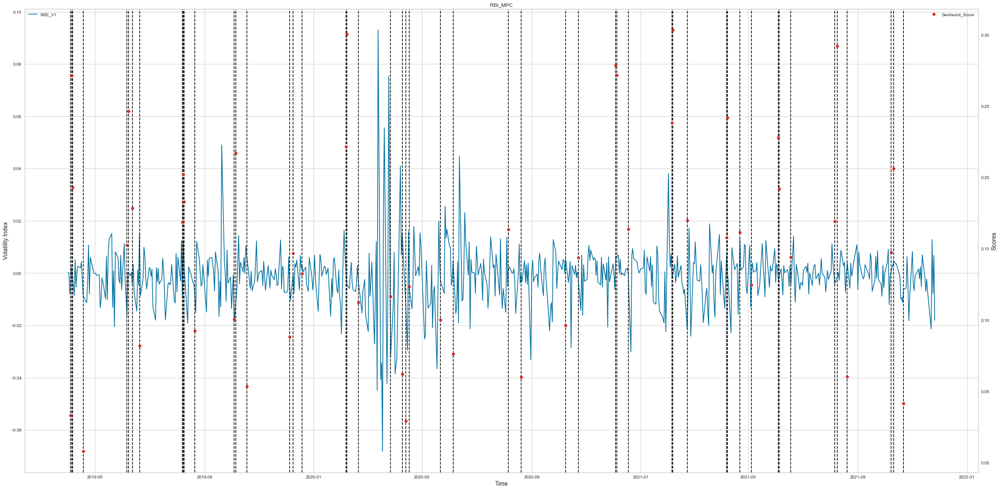

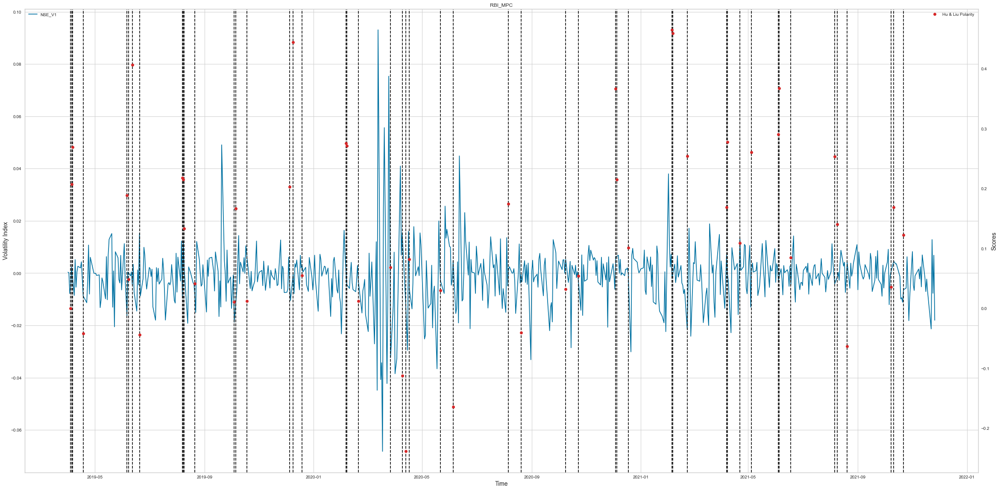

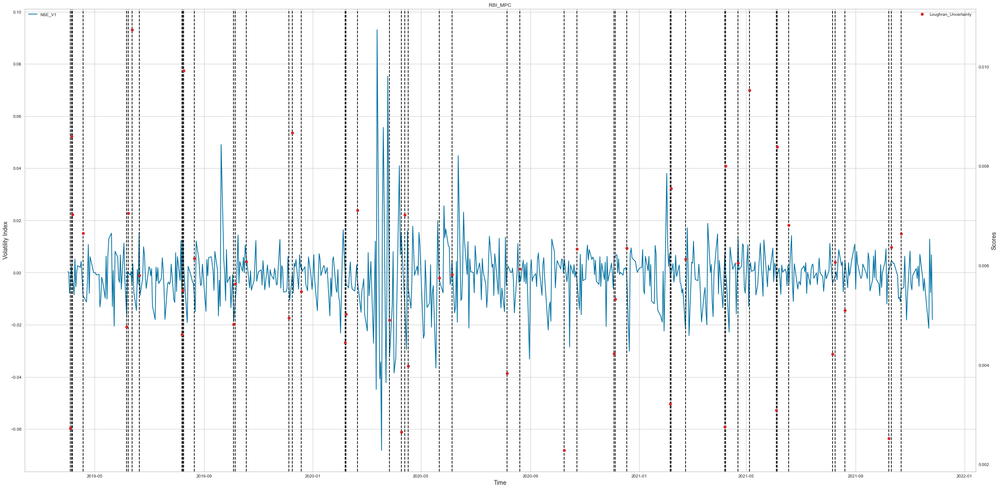

In [71]:
for i in range(2,9,1):
    # setting plot size
    plt.rcParams['figure.figsize'] = 40, 20
    # create figure and axis objects with subplots()
    fig,ax = plt.subplots()
    # make a plot of first y-axis
    ax.plot(bsensedata['NSE_V1'], color='b', label='NSE_V1')
    # set x-axis label
    ax.set_xlabel("Time",fontsize=14)
    # set y-axis label
    ax.set_ylabel("Volatility Index",fontsize=14)
    for xc in mpc_date:
        ax.axvline(x=xc, color='k', linestyle='dashed')
    ax.legend(loc=2)
    
    ax2=ax.twinx()
    # make a plot with different y-axis using second axis object
    ax2.plot(mpc_date, score_mpc_merge_date[score_mpc_merge_date.columns[[i]]], color='tab:red', label=score_mpc_merge_date.columns[i], linestyle='None', marker='o')
    ax2.set_ylabel("Scores",fontsize=14)
    ax2.legend(loc=1)
    plt.title('RBI_MPC')
    plt.grid()
    a = score_mpc_merge_date.columns[i]+'_RBI_MPC_Volatility_Index_NSE_V1'+".jpg"
    plt.savefig(a)
    plt.show()

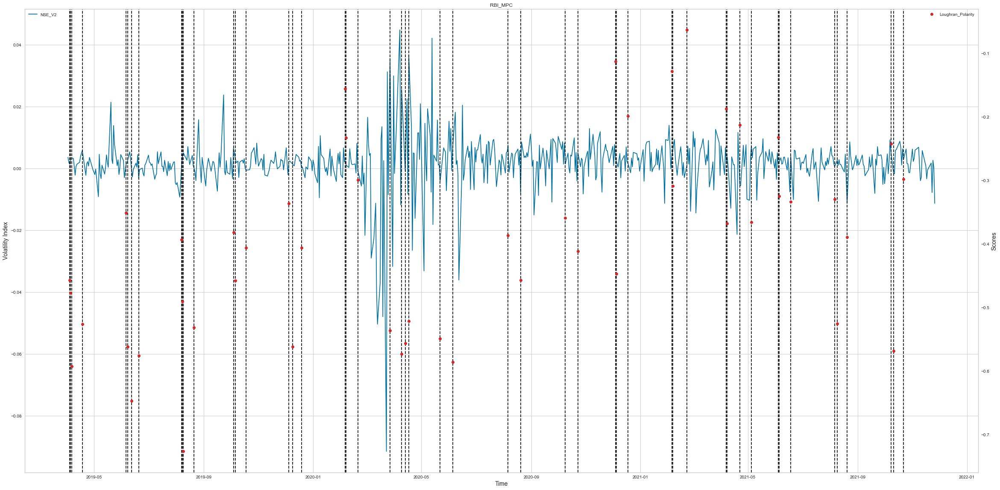

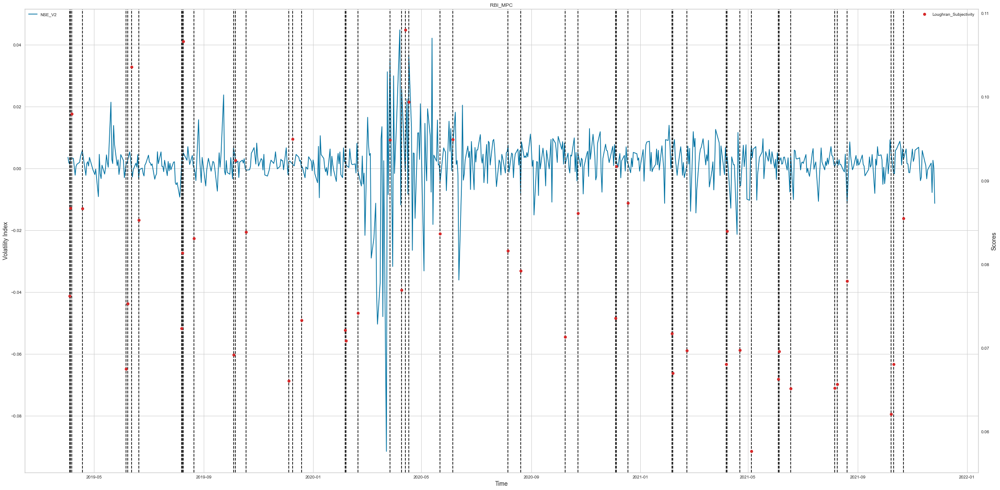

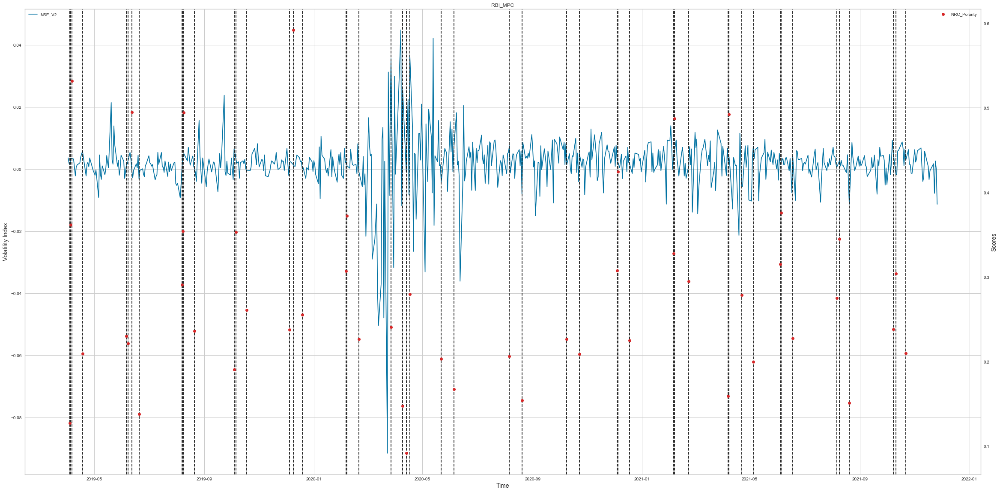

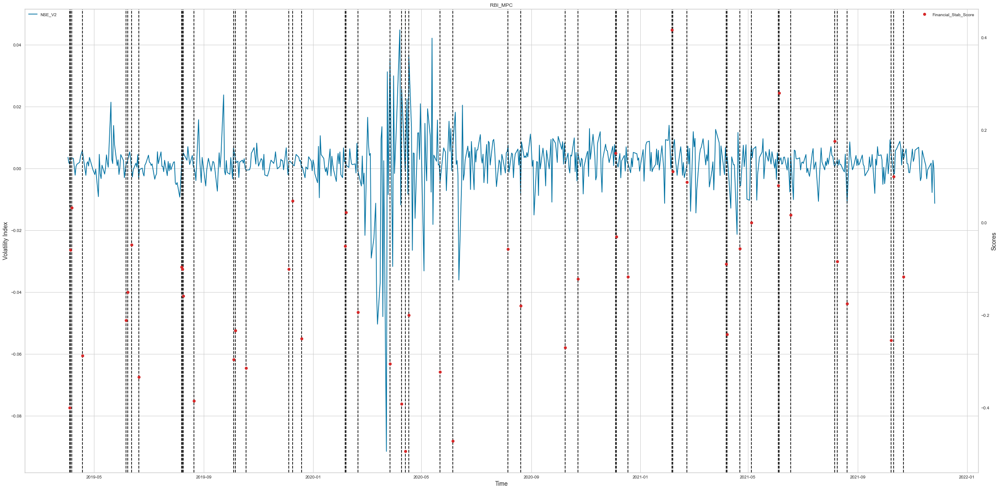

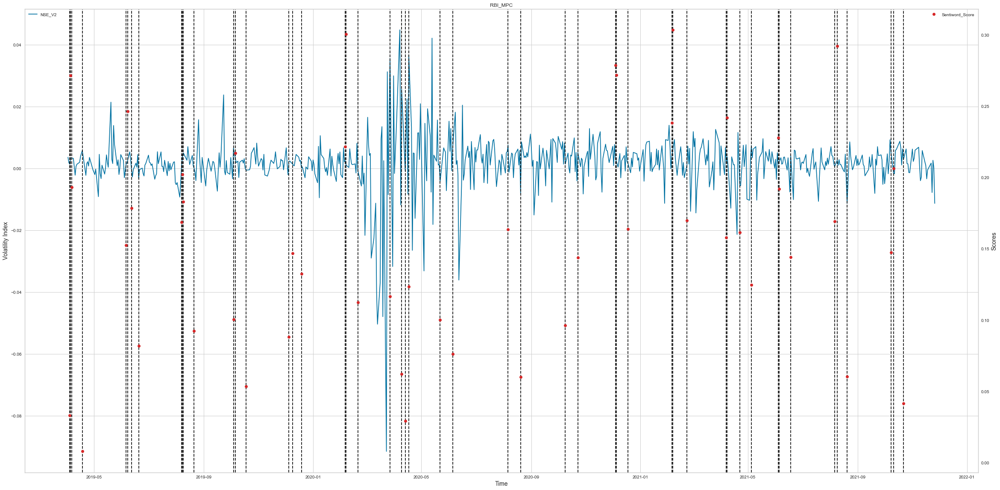

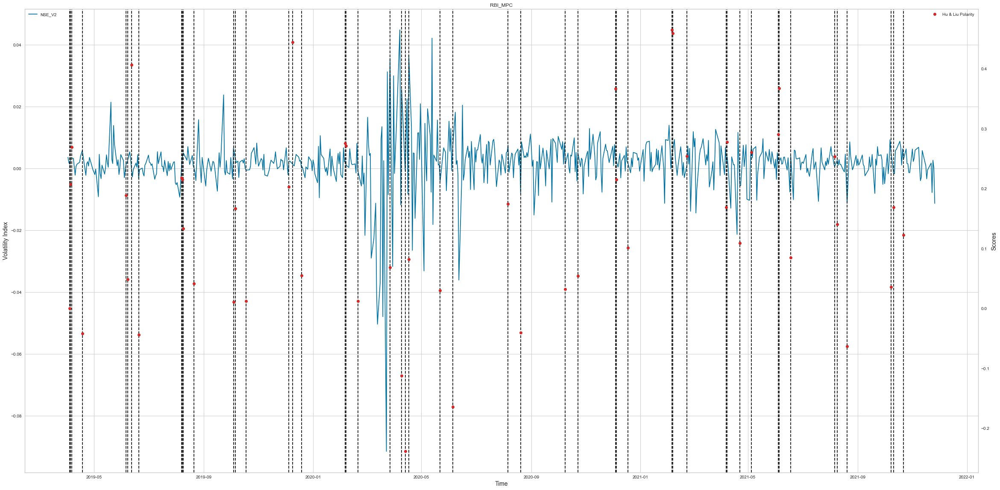

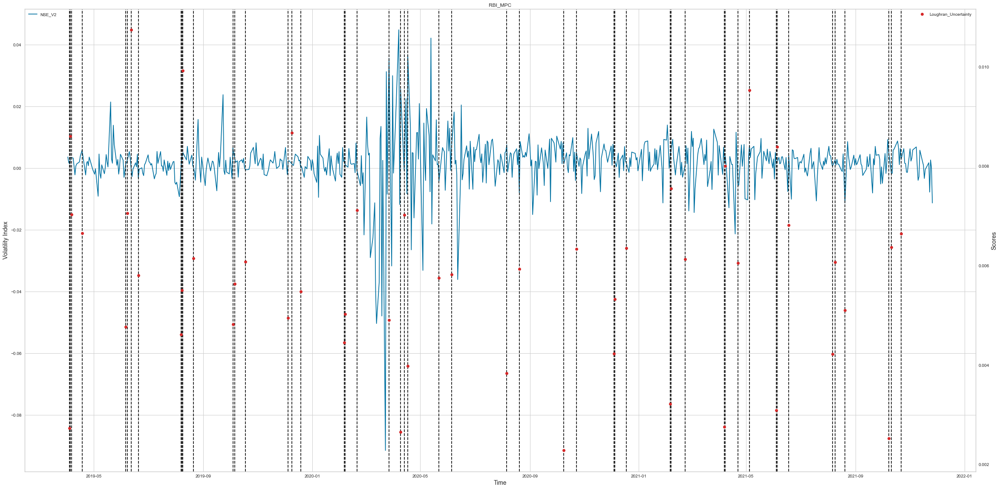

In [72]:
for i in range(2,9,1):
    # setting plot size
    plt.rcParams['figure.figsize'] = 40, 20
    # create figure and axis objects with subplots()
    fig,ax = plt.subplots()
    # make a plot of first y-axis
    ax.plot(bsensedata['NSE_V2'], color='b', label='NSE_V2')
    # set x-axis label
    ax.set_xlabel("Time",fontsize=14)
    # set y-axis label
    ax.set_ylabel("Volatility Index",fontsize=14)
    for xc in mpc_date:
        ax.axvline(x=xc, color='k', linestyle='dashed')
    ax.legend(loc=2)
    
    ax2=ax.twinx()
    # make a plot with different y-axis using second axis object
    ax2.plot(mpc_date, score_mpc_merge_date[score_mpc_merge_date.columns[[i]]], color='tab:red', label=score_mpc_merge_date.columns[i], linestyle='None', marker='o')
    ax2.set_ylabel("Scores",fontsize=14)
    ax2.legend(loc=1)
    plt.title('RBI_MPC')
    plt.grid()
    a = score_mpc_merge_date.columns[i]+'_RBI_MPC_Volatility_Index_NSE_V2'+".jpg"
    plt.savefig(a)
    plt.show()